<a href="https://colab.research.google.com/github/segsev/Machine-Translation/blob/master/gan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [12]:
cd Fer2013\ data

/content/drive/My Drive/Colab Notebooks/Fer2013 data


In [13]:
pwd

'/content/drive/My Drive/Colab Notebooks/Fer2013 data'

In [0]:
import pandas as pd
import numpy as np

In [15]:
ls

fer2013.csv  PrivateTest/  PrivateTestt/  PublicTest/  Training/


In [0]:
df = pd.read_csv('fer2013.csv')

In [0]:
train = df.loc[df['Usage'] == 'Training']

In [0]:
x_train = train['pixels']

In [19]:
for i in range(len(x_train)):
  x_train[i] = np.fromstring(x_train[i], dtype = int, sep = ' ')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2882: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  exec(code_obj, self.user_global_ns, self.user_ns)


In [0]:
a = list()
for i in range(len(x_train)):
  a.append(x_train[i])
X = np.asarray(a)

In [21]:
X.shape

(28709, 2304)

In [22]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import keras
from keras.layers import Dense, Dropout, Input
from keras.models import Model,Sequential
from keras.datasets import mnist
from tqdm import tqdm
from keras.layers.advanced_activations import LeakyReLU
from keras.optimizers import Adam

Using TensorFlow backend.


In [0]:
def load_data():
    
    X_train = (X.astype(np.float32) - 127.5)/127.5
    
    # convert shape of x_train from (60000, 28, 28) to (60000, 784) 
    # 784 columns per row
    return X_train
#print(X_train.shape)

In [0]:
def adam_optimizer():
    return Adam(lr=0.0002, beta_1=0.5)

In [26]:
def create_generator():
    generator=Sequential()
    generator.add(Dense(units=256,input_dim=100))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Dense(units=512))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Dense(units=1024))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Dense(units=2304, activation='tanh'))
    
    generator.compile(loss='binary_crossentropy', optimizer=adam_optimizer())
    return generator
g=create_generator()
g.summary()






Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 256)               25856     
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 256)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 512)               131584    
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 512)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 1024)              525312    
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 1024)              0         
_____________________

In [27]:
def create_discriminator():
    discriminator=Sequential()
    discriminator.add(Dense(units=1024,input_dim=2304))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.3))
       
    
    discriminator.add(Dense(units=512))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.3))
       
    discriminator.add(Dense(units=256))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Dense(units=1, activation='sigmoid'))
    
    discriminator.compile(loss='binary_crossentropy', optimizer=adam_optimizer())
    return discriminator
d =create_discriminator()
d.summary()


Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_5 (Dense)              (None, 1024)              2360320   
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 1024)              0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 1024)              0         
_________________________________________________________________
dense_6 (Dense)              (None, 512)               524800    
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 512)               0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 512)               0         
____

In [28]:
def create_gan(discriminator, generator):
    discriminator.trainable=False
    gan_input = Input(shape=(100,))
    x = generator(gan_input)
    gan_output= discriminator(x)
    gan= Model(inputs=gan_input, outputs=gan_output)
    gan.compile(loss='binary_crossentropy', optimizer='adam')
    return gan
gan = create_gan(d,g)
gan.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 100)               0         
_________________________________________________________________
sequential_1 (Sequential)    (None, 2304)              3044352   
_________________________________________________________________
sequential_2 (Sequential)    (None, 1)                 3016705   
Total params: 6,061,057
Trainable params: 3,044,352
Non-trainable params: 3,016,705
_________________________________________________________________


In [0]:
def plot_generated_images(epoch, generator, examples=100, dim=(10,10), figsize=(10,10)):
    noise= np.random.normal(loc=0, scale=1, size=[examples, 100])
    generated_images = generator.predict(noise)
    generated_images = generated_images.reshape(100,48,48)
    plt.figure(figsize=figsize)
    for i in range(generated_images.shape[0]):
        plt.subplot(dim[0], dim[1], i+1)
        plt.imshow(generated_images[i], interpolation='nearest')
        plt.axis('off')
    plt.tight_layout()
    plt.savefig('../gan_generated_image %d.png' %epoch)

  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 1










  5%|▍         | 6/128 [00:00<00:02, 51.89it/s]

Epoch 2


  5%|▌         | 7/128 [00:00<00:01, 62.25it/s]

Epoch 3


  5%|▍         | 6/128 [00:00<00:02, 59.63it/s]

Epoch 4


  4%|▍         | 5/128 [00:00<00:02, 43.60it/s]

Epoch 5


  5%|▌         | 7/128 [00:00<00:01, 60.79it/s]

Epoch 6


  5%|▍         | 6/128 [00:00<00:02, 52.93it/s]

Epoch 7


  5%|▌         | 7/128 [00:00<00:01, 64.34it/s]

Epoch 8


  5%|▌         | 7/128 [00:00<00:01, 64.36it/s]

Epoch 9


  5%|▍         | 6/128 [00:00<00:02, 55.79it/s]

Epoch 10


  5%|▍         | 6/128 [00:00<00:02, 52.69it/s]

Epoch 11


  5%|▍         | 6/128 [00:00<00:02, 57.06it/s]

Epoch 12


  5%|▌         | 7/128 [00:00<00:01, 64.52it/s]

Epoch 13


  5%|▌         | 7/128 [00:00<00:01, 65.91it/s]

Epoch 14


  4%|▍         | 5/128 [00:00<00:02, 43.53it/s]

Epoch 15


  5%|▌         | 7/128 [00:00<00:01, 63.29it/s]

Epoch 16


  5%|▍         | 6/128 [00:00<00:02, 58.07it/s]

Epoch 17


  5%|▌         | 7/128 [00:00<00:01, 61.04it/s]

Epoch 18


  5%|▍         | 6/128 [00:00<00:02, 59.83it/s]

Epoch 19


  5%|▌         | 7/128 [00:00<00:01, 63.27it/s]

Epoch 20


  5%|▍         | 6/128 [00:00<00:02, 58.43it/s]

Epoch 21


  5%|▍         | 6/128 [00:00<00:02, 56.89it/s]

Epoch 22


  4%|▍         | 5/128 [00:00<00:02, 47.24it/s]

Epoch 23


  5%|▌         | 7/128 [00:00<00:01, 62.58it/s]

Epoch 24


  5%|▌         | 7/128 [00:00<00:01, 64.67it/s]

Epoch 25


  5%|▌         | 7/128 [00:00<00:01, 61.82it/s]

Epoch 26


  5%|▍         | 6/128 [00:00<00:02, 55.28it/s]

Epoch 27


  4%|▍         | 5/128 [00:00<00:02, 46.57it/s]

Epoch 28


  4%|▍         | 5/128 [00:00<00:02, 47.82it/s]

Epoch 29


  5%|▌         | 7/128 [00:00<00:01, 66.36it/s]

Epoch 30


  5%|▌         | 7/128 [00:00<00:02, 59.75it/s]

Epoch 31


  5%|▍         | 6/128 [00:00<00:02, 58.29it/s]

Epoch 32


  5%|▍         | 6/128 [00:00<00:02, 50.06it/s]

Epoch 33


  5%|▍         | 6/128 [00:00<00:02, 55.88it/s]

Epoch 34


  5%|▌         | 7/128 [00:00<00:01, 64.91it/s]

Epoch 35


  5%|▌         | 7/128 [00:00<00:01, 66.19it/s]

Epoch 36


  5%|▌         | 7/128 [00:00<00:01, 64.52it/s]

Epoch 37


  5%|▍         | 6/128 [00:00<00:02, 52.00it/s]

Epoch 38


  5%|▍         | 6/128 [00:00<00:02, 56.94it/s]

Epoch 39


  5%|▌         | 7/128 [00:00<00:01, 65.24it/s]

Epoch 40


  5%|▌         | 7/128 [00:00<00:01, 61.24it/s]

Epoch 41


  5%|▌         | 7/128 [00:00<00:01, 67.03it/s]

Epoch 42


  5%|▍         | 6/128 [00:00<00:02, 58.39it/s]

Epoch 43


  5%|▍         | 6/128 [00:00<00:02, 58.74it/s]

Epoch 44


  5%|▌         | 7/128 [00:00<00:01, 63.14it/s]

Epoch 45


  5%|▌         | 7/128 [00:00<00:01, 63.54it/s]

Epoch 46


  5%|▌         | 7/128 [00:00<00:01, 61.47it/s]

Epoch 47


  5%|▌         | 7/128 [00:00<00:01, 60.78it/s]

Epoch 48


  5%|▍         | 6/128 [00:00<00:02, 57.41it/s]

Epoch 49


  5%|▍         | 6/128 [00:00<00:02, 58.45it/s]

Epoch 50


  5%|▍         | 6/128 [00:00<00:02, 55.31it/s]

Epoch 51


  5%|▌         | 7/128 [00:00<00:01, 61.31it/s]

Epoch 52


  5%|▌         | 7/128 [00:00<00:01, 65.01it/s]

Epoch 53


  5%|▌         | 7/128 [00:00<00:01, 61.26it/s]

Epoch 54


  5%|▍         | 6/128 [00:00<00:02, 59.71it/s]

Epoch 55


  5%|▍         | 6/128 [00:00<00:02, 52.04it/s]

Epoch 56


  5%|▌         | 7/128 [00:00<00:01, 63.52it/s]

Epoch 57


  5%|▌         | 7/128 [00:00<00:01, 64.26it/s]

Epoch 58


  5%|▍         | 6/128 [00:00<00:02, 59.25it/s]

Epoch 59


  5%|▌         | 7/128 [00:00<00:01, 62.98it/s]

Epoch 60


  5%|▍         | 6/128 [00:00<00:02, 57.77it/s]

Epoch 61


  5%|▌         | 7/128 [00:00<00:01, 62.73it/s]

Epoch 62


  5%|▌         | 7/128 [00:00<00:01, 66.21it/s]

Epoch 63


  5%|▌         | 7/128 [00:00<00:01, 61.80it/s]

Epoch 64


  5%|▌         | 7/128 [00:00<00:01, 63.07it/s]

Epoch 65


  5%|▌         | 7/128 [00:00<00:01, 61.76it/s]

Epoch 66


  5%|▌         | 7/128 [00:00<00:01, 64.98it/s]

Epoch 67


  5%|▌         | 7/128 [00:00<00:01, 63.49it/s]

Epoch 68


  5%|▌         | 7/128 [00:00<00:01, 65.13it/s]

Epoch 69


  5%|▌         | 7/128 [00:00<00:01, 67.77it/s]

Epoch 70


  5%|▌         | 7/128 [00:00<00:01, 62.74it/s]

Epoch 71


  5%|▌         | 7/128 [00:00<00:01, 62.61it/s]

Epoch 72


  5%|▌         | 7/128 [00:00<00:01, 64.67it/s]

Epoch 73


  5%|▌         | 7/128 [00:00<00:01, 64.67it/s]

Epoch 74


  5%|▌         | 7/128 [00:00<00:01, 61.96it/s]

Epoch 75


  5%|▌         | 7/128 [00:00<00:01, 64.97it/s]

Epoch 76


  5%|▌         | 7/128 [00:00<00:01, 65.99it/s]

Epoch 77


  5%|▌         | 7/128 [00:00<00:01, 66.73it/s]

Epoch 78


  5%|▌         | 7/128 [00:00<00:01, 63.54it/s]

Epoch 79


  5%|▌         | 7/128 [00:00<00:01, 62.94it/s]

Epoch 80


  5%|▍         | 6/128 [00:00<00:02, 57.36it/s]

Epoch 81


  5%|▍         | 6/128 [00:00<00:02, 57.15it/s]

Epoch 82


  5%|▍         | 6/128 [00:00<00:02, 55.50it/s]

Epoch 83


  5%|▍         | 6/128 [00:00<00:02, 58.26it/s]

Epoch 84


  5%|▍         | 6/128 [00:00<00:02, 58.30it/s]

Epoch 85


  5%|▌         | 7/128 [00:00<00:01, 63.73it/s]

Epoch 86


  5%|▌         | 7/128 [00:00<00:01, 66.41it/s]

Epoch 87


  5%|▌         | 7/128 [00:00<00:01, 64.90it/s]

Epoch 88


  5%|▌         | 7/128 [00:00<00:01, 67.67it/s]

Epoch 89


  5%|▌         | 7/128 [00:00<00:01, 64.42it/s]

Epoch 90


  5%|▌         | 7/128 [00:00<00:01, 62.43it/s]

Epoch 91


  5%|▌         | 7/128 [00:00<00:01, 64.72it/s]

Epoch 92


  5%|▌         | 7/128 [00:00<00:01, 64.82it/s]

Epoch 93


  5%|▌         | 7/128 [00:00<00:01, 64.24it/s]

Epoch 94


  5%|▌         | 7/128 [00:00<00:01, 62.20it/s]

Epoch 95


  5%|▌         | 7/128 [00:00<00:01, 61.26it/s]

Epoch 96


  5%|▌         | 7/128 [00:00<00:01, 63.44it/s]

Epoch 97


  5%|▌         | 7/128 [00:00<00:01, 61.54it/s]

Epoch 98


  5%|▌         | 7/128 [00:00<00:01, 65.65it/s]

Epoch 99


  5%|▌         | 7/128 [00:00<00:01, 65.11it/s]

Epoch 100


  5%|▌         | 7/128 [00:00<00:01, 63.33it/s]

Epoch 101


  5%|▌         | 7/128 [00:00<00:01, 66.65it/s]

Epoch 102


  5%|▌         | 7/128 [00:00<00:01, 65.55it/s]

Epoch 103


  5%|▌         | 7/128 [00:00<00:01, 60.67it/s]

Epoch 104


  6%|▋         | 8/128 [00:00<00:01, 71.60it/s]

Epoch 105


100%|██████████| 128/128 [00:01<00:00, 64.93it/s]
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
  5%|▌         | 7/128 [00:00<00:01, 66.78it/s]

Epoch 106


  6%|▋         | 8/128 [00:00<00:01, 73.13it/s]

Epoch 107


  5%|▌         | 7/128 [00:00<00:01, 68.51it/s]

Epoch 108


  5%|▌         | 7/128 [00:00<00:01, 66.96it/s]

Epoch 109


  5%|▌         | 7/128 [00:00<00:01, 66.43it/s]

Epoch 110


  5%|▌         | 7/128 [00:00<00:01, 66.11it/s]

Epoch 111


  5%|▌         | 7/128 [00:00<00:01, 63.13it/s]

Epoch 112


  5%|▌         | 7/128 [00:00<00:01, 67.87it/s]

Epoch 113


  5%|▌         | 7/128 [00:00<00:01, 64.43it/s]

Epoch 114


  5%|▌         | 7/128 [00:00<00:01, 68.79it/s]

Epoch 115


  5%|▌         | 7/128 [00:00<00:01, 64.68it/s]

Epoch 116


  5%|▌         | 7/128 [00:00<00:01, 69.35it/s]

Epoch 117


  6%|▋         | 8/128 [00:00<00:01, 71.75it/s]

Epoch 118


  5%|▌         | 7/128 [00:00<00:01, 67.47it/s]

Epoch 119


  5%|▌         | 7/128 [00:00<00:01, 64.61it/s]

Epoch 120


  5%|▌         | 7/128 [00:00<00:01, 66.29it/s]

Epoch 121


  6%|▋         | 8/128 [00:00<00:01, 70.38it/s]

Epoch 122


  5%|▌         | 7/128 [00:00<00:01, 66.66it/s]

Epoch 123


  5%|▌         | 7/128 [00:00<00:01, 66.62it/s]

Epoch 124


  5%|▍         | 6/128 [00:00<00:02, 54.55it/s]

Epoch 125


  5%|▌         | 7/128 [00:00<00:01, 62.19it/s]

Epoch 126


  5%|▌         | 7/128 [00:00<00:01, 64.20it/s]

Epoch 127


  5%|▌         | 7/128 [00:00<00:01, 66.07it/s]

Epoch 128


  5%|▌         | 7/128 [00:00<00:01, 68.20it/s]

Epoch 129


  5%|▌         | 7/128 [00:00<00:01, 69.11it/s]

Epoch 130


  6%|▋         | 8/128 [00:00<00:01, 70.94it/s]

Epoch 131


  5%|▌         | 7/128 [00:00<00:01, 69.36it/s]

Epoch 132


  5%|▌         | 7/128 [00:00<00:01, 68.56it/s]

Epoch 133


  6%|▋         | 8/128 [00:00<00:01, 73.00it/s]

Epoch 134


  5%|▌         | 7/128 [00:00<00:01, 68.44it/s]

Epoch 135


  6%|▋         | 8/128 [00:00<00:01, 71.48it/s]

Epoch 136


  5%|▍         | 6/128 [00:00<00:02, 59.38it/s]

Epoch 137


  5%|▌         | 7/128 [00:00<00:01, 68.20it/s]

Epoch 138


  5%|▌         | 7/128 [00:00<00:01, 67.60it/s]

Epoch 139


  5%|▌         | 7/128 [00:00<00:01, 68.87it/s]

Epoch 140


  5%|▌         | 7/128 [00:00<00:01, 68.56it/s]

Epoch 141


  5%|▌         | 7/128 [00:00<00:01, 67.81it/s]

Epoch 142


  5%|▌         | 7/128 [00:00<00:01, 62.81it/s]

Epoch 143


  5%|▌         | 7/128 [00:00<00:01, 69.10it/s]

Epoch 144


  5%|▍         | 6/128 [00:00<00:02, 59.99it/s]

Epoch 145


  5%|▌         | 7/128 [00:00<00:01, 62.25it/s]

Epoch 146


  5%|▌         | 7/128 [00:00<00:01, 68.17it/s]

Epoch 147


  5%|▌         | 7/128 [00:00<00:01, 65.96it/s]

Epoch 148


  5%|▌         | 7/128 [00:00<00:01, 62.47it/s]

Epoch 149


  5%|▌         | 7/128 [00:00<00:01, 66.57it/s]

Epoch 150


  5%|▌         | 7/128 [00:00<00:01, 65.03it/s]

Epoch 151


  5%|▌         | 7/128 [00:00<00:01, 64.63it/s]

Epoch 152


  5%|▌         | 7/128 [00:00<00:01, 65.48it/s]

Epoch 153


  5%|▌         | 7/128 [00:00<00:01, 64.99it/s]

Epoch 154


  6%|▋         | 8/128 [00:00<00:01, 70.14it/s]

Epoch 155


  5%|▌         | 7/128 [00:00<00:01, 65.59it/s]

Epoch 156


  5%|▌         | 7/128 [00:00<00:01, 64.14it/s]

Epoch 157


  5%|▌         | 7/128 [00:00<00:01, 67.03it/s]

Epoch 158


  5%|▌         | 7/128 [00:00<00:01, 65.07it/s]

Epoch 159


  5%|▌         | 7/128 [00:00<00:01, 67.99it/s]

Epoch 160


  5%|▌         | 7/128 [00:00<00:01, 65.80it/s]

Epoch 161


  5%|▌         | 7/128 [00:00<00:01, 66.08it/s]

Epoch 162


  5%|▍         | 6/128 [00:00<00:02, 59.70it/s]

Epoch 163


  6%|▋         | 8/128 [00:00<00:01, 69.65it/s]

Epoch 164


  5%|▌         | 7/128 [00:00<00:01, 66.92it/s]

Epoch 165


  5%|▌         | 7/128 [00:00<00:01, 62.88it/s]

Epoch 166


  5%|▌         | 7/128 [00:00<00:01, 66.51it/s]

Epoch 167


  5%|▌         | 7/128 [00:00<00:02, 59.91it/s]

Epoch 168


  5%|▌         | 7/128 [00:00<00:01, 68.37it/s]

Epoch 169


  5%|▌         | 7/128 [00:00<00:01, 67.13it/s]

Epoch 170


  5%|▌         | 7/128 [00:00<00:01, 65.48it/s]

Epoch 171


  5%|▌         | 7/128 [00:00<00:01, 65.58it/s]

Epoch 172


  5%|▌         | 7/128 [00:00<00:01, 64.29it/s]

Epoch 173


  5%|▌         | 7/128 [00:00<00:01, 67.55it/s]

Epoch 174


  5%|▌         | 7/128 [00:00<00:01, 62.66it/s]

Epoch 175


  5%|▌         | 7/128 [00:00<00:01, 65.06it/s]

Epoch 176


  5%|▌         | 7/128 [00:00<00:01, 65.01it/s]

Epoch 177


  6%|▋         | 8/128 [00:00<00:01, 71.32it/s]

Epoch 178


  5%|▌         | 7/128 [00:00<00:01, 62.10it/s]

Epoch 179


  5%|▌         | 7/128 [00:00<00:01, 63.84it/s]

Epoch 180


  5%|▌         | 7/128 [00:00<00:01, 67.28it/s]

Epoch 181


  6%|▋         | 8/128 [00:00<00:01, 73.42it/s]

Epoch 182


  5%|▌         | 7/128 [00:00<00:01, 65.52it/s]

Epoch 183


  5%|▌         | 7/128 [00:00<00:01, 63.92it/s]

Epoch 184


  5%|▌         | 7/128 [00:00<00:01, 60.53it/s]

Epoch 185


  5%|▌         | 7/128 [00:00<00:01, 69.25it/s]

Epoch 186


  5%|▌         | 7/128 [00:00<00:01, 67.35it/s]

Epoch 187


  5%|▌         | 7/128 [00:00<00:01, 63.59it/s]

Epoch 188


  5%|▌         | 7/128 [00:00<00:01, 67.67it/s]

Epoch 189


  5%|▌         | 7/128 [00:00<00:01, 63.74it/s]

Epoch 190


  5%|▌         | 7/128 [00:00<00:01, 67.02it/s]

Epoch 191


  6%|▋         | 8/128 [00:00<00:01, 70.52it/s]

Epoch 192


  5%|▌         | 7/128 [00:00<00:01, 66.56it/s]

Epoch 193


  6%|▋         | 8/128 [00:00<00:01, 70.79it/s]

Epoch 194


  5%|▌         | 7/128 [00:00<00:02, 60.05it/s]

Epoch 195


  5%|▌         | 7/128 [00:00<00:01, 64.49it/s]

Epoch 196


  5%|▌         | 7/128 [00:00<00:01, 67.18it/s]

Epoch 197


  5%|▌         | 7/128 [00:00<00:01, 66.91it/s]

Epoch 198


  5%|▌         | 7/128 [00:00<00:01, 61.42it/s]

Epoch 199


  5%|▌         | 7/128 [00:00<00:01, 67.24it/s]

Epoch 200


  5%|▌         | 7/128 [00:00<00:01, 63.50it/s]

Epoch 201


  6%|▋         | 8/128 [00:00<00:01, 71.14it/s]

Epoch 202


  6%|▋         | 8/128 [00:00<00:01, 71.04it/s]

Epoch 203


  5%|▌         | 7/128 [00:00<00:01, 62.50it/s]

Epoch 204


  5%|▌         | 7/128 [00:00<00:01, 67.37it/s]

Epoch 205


  5%|▌         | 7/128 [00:00<00:01, 66.79it/s]

Epoch 206


  5%|▌         | 7/128 [00:00<00:01, 68.49it/s]

Epoch 207


  6%|▋         | 8/128 [00:00<00:01, 71.33it/s]

Epoch 208


  5%|▌         | 7/128 [00:00<00:01, 67.75it/s]

Epoch 209


  6%|▋         | 8/128 [00:00<00:01, 72.59it/s]

Epoch 210


  5%|▌         | 7/128 [00:00<00:01, 65.51it/s]

Epoch 211


  5%|▌         | 7/128 [00:00<00:01, 65.18it/s]

Epoch 212


  5%|▌         | 7/128 [00:00<00:01, 69.94it/s]

Epoch 213


  5%|▌         | 7/128 [00:00<00:01, 69.04it/s]

Epoch 214


  5%|▌         | 7/128 [00:00<00:01, 64.04it/s]

Epoch 215


  5%|▌         | 7/128 [00:00<00:01, 67.05it/s]

Epoch 216


  5%|▌         | 7/128 [00:00<00:01, 69.09it/s]

Epoch 217


  5%|▌         | 7/128 [00:00<00:01, 69.31it/s]

Epoch 218


  5%|▌         | 7/128 [00:00<00:01, 67.21it/s]

Epoch 219


  5%|▌         | 7/128 [00:00<00:01, 64.85it/s]

Epoch 220


  5%|▌         | 7/128 [00:00<00:01, 60.63it/s]

Epoch 221


  5%|▌         | 7/128 [00:00<00:01, 66.84it/s]

Epoch 222


  5%|▌         | 7/128 [00:00<00:01, 63.87it/s]

Epoch 223


  5%|▌         | 7/128 [00:00<00:01, 61.81it/s]

Epoch 224


  5%|▌         | 7/128 [00:00<00:01, 63.79it/s]

Epoch 225


  5%|▌         | 7/128 [00:00<00:01, 68.44it/s]

Epoch 226


  5%|▌         | 7/128 [00:00<00:01, 69.00it/s]

Epoch 227


  6%|▋         | 8/128 [00:00<00:01, 70.45it/s]

Epoch 228


  5%|▌         | 7/128 [00:00<00:01, 69.48it/s]

Epoch 229


  5%|▌         | 7/128 [00:00<00:01, 63.31it/s]

Epoch 230


  5%|▌         | 7/128 [00:00<00:01, 64.29it/s]

Epoch 231


  5%|▌         | 7/128 [00:00<00:01, 64.87it/s]

Epoch 232


  6%|▋         | 8/128 [00:00<00:01, 71.13it/s]

Epoch 233


  6%|▋         | 8/128 [00:00<00:01, 72.27it/s]

Epoch 234


  5%|▌         | 7/128 [00:00<00:01, 69.47it/s]

Epoch 235


  5%|▌         | 7/128 [00:00<00:01, 62.37it/s]

Epoch 236


  5%|▌         | 7/128 [00:00<00:01, 61.57it/s]

Epoch 237


  5%|▍         | 6/128 [00:00<00:02, 55.61it/s]

Epoch 238


  5%|▌         | 7/128 [00:00<00:01, 66.10it/s]

Epoch 239


  6%|▋         | 8/128 [00:00<00:01, 71.02it/s]

Epoch 240


  5%|▌         | 7/128 [00:00<00:01, 64.82it/s]

Epoch 241


  6%|▋         | 8/128 [00:00<00:01, 68.33it/s]

Epoch 242


  5%|▌         | 7/128 [00:00<00:01, 68.63it/s]

Epoch 243


  6%|▋         | 8/128 [00:00<00:01, 70.88it/s]

Epoch 244


  5%|▌         | 7/128 [00:00<00:01, 64.59it/s]

Epoch 245


  5%|▌         | 7/128 [00:00<00:01, 64.96it/s]

Epoch 246


  6%|▋         | 8/128 [00:00<00:01, 70.01it/s]

Epoch 247


  5%|▌         | 7/128 [00:00<00:01, 69.85it/s]

Epoch 248


  5%|▌         | 7/128 [00:00<00:01, 65.66it/s]

Epoch 249


  5%|▌         | 7/128 [00:00<00:01, 63.44it/s]

Epoch 250


  5%|▌         | 7/128 [00:00<00:01, 63.86it/s]

Epoch 251


  5%|▌         | 7/128 [00:00<00:01, 66.90it/s]

Epoch 252


  5%|▌         | 7/128 [00:00<00:01, 66.82it/s]

Epoch 253


  6%|▋         | 8/128 [00:00<00:01, 70.78it/s]

Epoch 254


  5%|▌         | 7/128 [00:00<00:01, 66.88it/s]

Epoch 255


  5%|▌         | 7/128 [00:00<00:01, 61.56it/s]

Epoch 256


  5%|▌         | 7/128 [00:00<00:01, 65.78it/s]

Epoch 257


  5%|▌         | 7/128 [00:00<00:01, 69.58it/s]

Epoch 258


  5%|▌         | 7/128 [00:00<00:01, 65.04it/s]

Epoch 259


  5%|▌         | 7/128 [00:00<00:01, 68.46it/s]

Epoch 260


  5%|▌         | 7/128 [00:00<00:01, 61.54it/s]

Epoch 261


  5%|▌         | 7/128 [00:00<00:01, 69.24it/s]

Epoch 262


  5%|▌         | 7/128 [00:00<00:01, 65.69it/s]

Epoch 263


  5%|▌         | 7/128 [00:00<00:01, 60.85it/s]

Epoch 264


  5%|▌         | 7/128 [00:00<00:01, 68.94it/s]

Epoch 265


  5%|▌         | 7/128 [00:00<00:01, 67.23it/s]

Epoch 266


  6%|▋         | 8/128 [00:00<00:01, 74.31it/s]

Epoch 267


  5%|▌         | 7/128 [00:00<00:01, 67.69it/s]

Epoch 268


  5%|▌         | 7/128 [00:00<00:01, 67.42it/s]

Epoch 269


  5%|▌         | 7/128 [00:00<00:01, 65.11it/s]

Epoch 270


  5%|▌         | 7/128 [00:00<00:01, 65.27it/s]

Epoch 271


  6%|▋         | 8/128 [00:00<00:01, 70.89it/s]

Epoch 272


  5%|▌         | 7/128 [00:00<00:01, 64.82it/s]

Epoch 273


  6%|▋         | 8/128 [00:00<00:01, 71.64it/s]

Epoch 274


  5%|▌         | 7/128 [00:00<00:01, 64.18it/s]

Epoch 275


  5%|▌         | 7/128 [00:00<00:01, 65.11it/s]

Epoch 276


  5%|▌         | 7/128 [00:00<00:01, 67.88it/s]

Epoch 277


  6%|▋         | 8/128 [00:00<00:01, 71.03it/s]

Epoch 278


  5%|▌         | 7/128 [00:00<00:01, 69.49it/s]

Epoch 279


  5%|▌         | 7/128 [00:00<00:01, 65.42it/s]

Epoch 280


  5%|▌         | 7/128 [00:00<00:01, 69.08it/s]

Epoch 281


  5%|▌         | 7/128 [00:00<00:01, 60.66it/s]

Epoch 282


  5%|▌         | 7/128 [00:00<00:01, 68.29it/s]

Epoch 283


  6%|▋         | 8/128 [00:00<00:01, 72.98it/s]

Epoch 284


  5%|▌         | 7/128 [00:00<00:01, 68.44it/s]

Epoch 285


  5%|▌         | 7/128 [00:00<00:01, 68.05it/s]

Epoch 286


  6%|▋         | 8/128 [00:00<00:01, 71.99it/s]

Epoch 287


  5%|▌         | 7/128 [00:00<00:01, 66.69it/s]

Epoch 288


  5%|▌         | 7/128 [00:00<00:01, 64.07it/s]

Epoch 289


  5%|▌         | 7/128 [00:00<00:01, 67.45it/s]

Epoch 290


  5%|▌         | 7/128 [00:00<00:01, 65.55it/s]

Epoch 291


  6%|▋         | 8/128 [00:00<00:01, 69.69it/s]

Epoch 292


  5%|▍         | 6/128 [00:00<00:02, 59.84it/s]

Epoch 293


  5%|▍         | 6/128 [00:00<00:02, 59.52it/s]

Epoch 294


  5%|▌         | 7/128 [00:00<00:01, 67.73it/s]

Epoch 295


  5%|▌         | 7/128 [00:00<00:01, 64.36it/s]

Epoch 296


  5%|▌         | 7/128 [00:00<00:01, 65.06it/s]

Epoch 297


  5%|▌         | 7/128 [00:00<00:01, 65.53it/s]

Epoch 298


  5%|▌         | 7/128 [00:00<00:01, 68.30it/s]

Epoch 299


  5%|▌         | 7/128 [00:00<00:01, 66.12it/s]

Epoch 300


  5%|▍         | 6/128 [00:00<00:02, 56.83it/s]

Epoch 301


  5%|▌         | 7/128 [00:00<00:01, 66.35it/s]

Epoch 302


  5%|▌         | 7/128 [00:00<00:01, 64.18it/s]

Epoch 303


  5%|▌         | 7/128 [00:00<00:01, 68.67it/s]

Epoch 304


  5%|▌         | 7/128 [00:00<00:01, 69.95it/s]

Epoch 305


  5%|▌         | 7/128 [00:00<00:01, 61.67it/s]

Epoch 306


  5%|▌         | 7/128 [00:00<00:01, 64.95it/s]

Epoch 307


  5%|▌         | 7/128 [00:00<00:01, 66.60it/s]

Epoch 308


  5%|▌         | 7/128 [00:00<00:01, 61.68it/s]

Epoch 309


  5%|▌         | 7/128 [00:00<00:01, 64.98it/s]

Epoch 310


  5%|▌         | 7/128 [00:00<00:01, 62.74it/s]

Epoch 311


  5%|▌         | 7/128 [00:00<00:01, 61.56it/s]

Epoch 312


  5%|▌         | 7/128 [00:00<00:01, 64.06it/s]

Epoch 313


  5%|▌         | 7/128 [00:00<00:01, 61.67it/s]

Epoch 314


  5%|▌         | 7/128 [00:00<00:01, 67.74it/s]

Epoch 315


  5%|▌         | 7/128 [00:00<00:02, 59.41it/s]

Epoch 316


  5%|▌         | 7/128 [00:00<00:01, 64.77it/s]

Epoch 317


  5%|▌         | 7/128 [00:00<00:01, 67.34it/s]

Epoch 318


  5%|▌         | 7/128 [00:00<00:01, 65.53it/s]

Epoch 319


  5%|▌         | 7/128 [00:00<00:01, 63.08it/s]

Epoch 320


  6%|▋         | 8/128 [00:00<00:01, 70.08it/s]

Epoch 321


  5%|▌         | 7/128 [00:00<00:01, 69.85it/s]

Epoch 322


  5%|▌         | 7/128 [00:00<00:01, 67.72it/s]

Epoch 323


  5%|▌         | 7/128 [00:00<00:01, 64.90it/s]

Epoch 324


  5%|▌         | 7/128 [00:00<00:01, 63.31it/s]

Epoch 325


  5%|▌         | 7/128 [00:00<00:01, 65.70it/s]

Epoch 326


  5%|▌         | 7/128 [00:00<00:01, 66.10it/s]

Epoch 327


  5%|▌         | 7/128 [00:00<00:01, 69.99it/s]

Epoch 328


  5%|▌         | 7/128 [00:00<00:01, 68.57it/s]

Epoch 329


  5%|▌         | 7/128 [00:00<00:01, 67.71it/s]

Epoch 330


  5%|▌         | 7/128 [00:00<00:01, 68.55it/s]

Epoch 331


  5%|▌         | 7/128 [00:00<00:01, 64.85it/s]

Epoch 332


  5%|▌         | 7/128 [00:00<00:01, 66.12it/s]

Epoch 333


  5%|▌         | 7/128 [00:00<00:01, 63.01it/s]

Epoch 334


  5%|▌         | 7/128 [00:00<00:01, 67.53it/s]

Epoch 335


  5%|▌         | 7/128 [00:00<00:01, 61.26it/s]

Epoch 336


  5%|▌         | 7/128 [00:00<00:01, 64.91it/s]

Epoch 337


  5%|▌         | 7/128 [00:00<00:01, 65.31it/s]

Epoch 338


  5%|▌         | 7/128 [00:00<00:01, 65.16it/s]

Epoch 339


  5%|▍         | 6/128 [00:00<00:02, 59.71it/s]

Epoch 340


  5%|▌         | 7/128 [00:00<00:01, 69.68it/s]

Epoch 341


  6%|▋         | 8/128 [00:00<00:01, 70.71it/s]

Epoch 342


  5%|▌         | 7/128 [00:00<00:01, 64.49it/s]

Epoch 343


  5%|▌         | 7/128 [00:00<00:01, 67.92it/s]

Epoch 344


  5%|▌         | 7/128 [00:00<00:01, 68.05it/s]

Epoch 345


  5%|▌         | 7/128 [00:00<00:01, 66.19it/s]

Epoch 346


  6%|▋         | 8/128 [00:00<00:01, 71.45it/s]

Epoch 347


  5%|▌         | 7/128 [00:00<00:01, 66.88it/s]

Epoch 348


  5%|▌         | 7/128 [00:00<00:01, 65.71it/s]

Epoch 349


  5%|▌         | 7/128 [00:00<00:01, 67.61it/s]

Epoch 350


  5%|▌         | 7/128 [00:00<00:01, 62.56it/s]

Epoch 351


  5%|▌         | 7/128 [00:00<00:01, 69.35it/s]

Epoch 352


  5%|▌         | 7/128 [00:00<00:01, 64.73it/s]

Epoch 353


  5%|▌         | 7/128 [00:00<00:01, 66.96it/s]

Epoch 354


  5%|▍         | 6/128 [00:00<00:02, 59.98it/s]

Epoch 355


  5%|▌         | 7/128 [00:00<00:01, 61.44it/s]

Epoch 356


  5%|▍         | 6/128 [00:00<00:02, 57.99it/s]

Epoch 357


  5%|▌         | 7/128 [00:00<00:01, 68.75it/s]

Epoch 358


  5%|▌         | 7/128 [00:00<00:01, 66.73it/s]

Epoch 359


  6%|▋         | 8/128 [00:00<00:01, 71.85it/s]

Epoch 360


  5%|▌         | 7/128 [00:00<00:01, 64.38it/s]

Epoch 361


  5%|▌         | 7/128 [00:00<00:01, 67.10it/s]

Epoch 362


  5%|▌         | 7/128 [00:00<00:01, 62.72it/s]

Epoch 363


  6%|▋         | 8/128 [00:00<00:01, 71.04it/s]

Epoch 364


  5%|▌         | 7/128 [00:00<00:01, 68.86it/s]

Epoch 365


  5%|▍         | 6/128 [00:00<00:02, 55.59it/s]

Epoch 366


  5%|▌         | 7/128 [00:00<00:01, 66.65it/s]

Epoch 367


  5%|▌         | 7/128 [00:00<00:01, 68.24it/s]

Epoch 368


  5%|▌         | 7/128 [00:00<00:01, 66.09it/s]

Epoch 369


  5%|▌         | 7/128 [00:00<00:01, 66.25it/s]

Epoch 370


  5%|▌         | 7/128 [00:00<00:01, 62.63it/s]

Epoch 371


  6%|▋         | 8/128 [00:00<00:01, 69.94it/s]

Epoch 372


  6%|▋         | 8/128 [00:00<00:01, 71.98it/s]

Epoch 373


  5%|▌         | 7/128 [00:00<00:01, 68.40it/s]

Epoch 374


  5%|▌         | 7/128 [00:00<00:01, 66.20it/s]

Epoch 375


  5%|▌         | 7/128 [00:00<00:01, 68.99it/s]

Epoch 376


  5%|▌         | 7/128 [00:00<00:01, 69.92it/s]

Epoch 377


  5%|▌         | 7/128 [00:00<00:01, 62.43it/s]

Epoch 378


  6%|▋         | 8/128 [00:00<00:01, 71.52it/s]

Epoch 379


  6%|▋         | 8/128 [00:00<00:01, 71.25it/s]

Epoch 380


  5%|▌         | 7/128 [00:00<00:01, 67.21it/s]

Epoch 381


  5%|▌         | 7/128 [00:00<00:01, 65.86it/s]

Epoch 382


  5%|▌         | 7/128 [00:00<00:01, 63.95it/s]

Epoch 383


  6%|▋         | 8/128 [00:00<00:01, 70.85it/s]

Epoch 384


  5%|▌         | 7/128 [00:00<00:01, 69.08it/s]

Epoch 385


  5%|▌         | 7/128 [00:00<00:01, 65.07it/s]

Epoch 386


  5%|▌         | 7/128 [00:00<00:01, 67.52it/s]

Epoch 387


  5%|▌         | 7/128 [00:00<00:01, 66.37it/s]

Epoch 388


  5%|▌         | 7/128 [00:00<00:01, 63.34it/s]

Epoch 389


  5%|▌         | 7/128 [00:00<00:01, 67.54it/s]

Epoch 390


  5%|▌         | 7/128 [00:00<00:01, 64.28it/s]

Epoch 391


  5%|▌         | 7/128 [00:00<00:01, 64.52it/s]

Epoch 392


  5%|▌         | 7/128 [00:00<00:01, 67.39it/s]

Epoch 393


  5%|▌         | 7/128 [00:00<00:01, 68.78it/s]

Epoch 394


  5%|▌         | 7/128 [00:00<00:01, 67.50it/s]

Epoch 395


  5%|▌         | 7/128 [00:00<00:01, 64.06it/s]

Epoch 396


  6%|▋         | 8/128 [00:00<00:01, 70.45it/s]

Epoch 397


  5%|▌         | 7/128 [00:00<00:01, 66.82it/s]

Epoch 398


  5%|▌         | 7/128 [00:00<00:01, 65.24it/s]

Epoch 399


  5%|▌         | 7/128 [00:00<00:01, 64.27it/s]

Epoch 400


  6%|▋         | 8/128 [00:00<00:01, 71.77it/s]

Epoch 401


  5%|▌         | 7/128 [00:00<00:01, 67.79it/s]

Epoch 402


  5%|▌         | 7/128 [00:00<00:01, 67.32it/s]

Epoch 403


  5%|▌         | 7/128 [00:00<00:01, 66.45it/s]

Epoch 404


  6%|▋         | 8/128 [00:00<00:01, 69.41it/s]

Epoch 405


  5%|▌         | 7/128 [00:00<00:01, 64.27it/s]

Epoch 406


  5%|▍         | 6/128 [00:00<00:02, 56.14it/s]

Epoch 407


  5%|▌         | 7/128 [00:00<00:01, 64.68it/s]

Epoch 408


  5%|▌         | 7/128 [00:00<00:01, 67.03it/s]

Epoch 409


  6%|▋         | 8/128 [00:00<00:01, 71.08it/s]

Epoch 410


  5%|▌         | 7/128 [00:00<00:01, 64.34it/s]

Epoch 411


  5%|▌         | 7/128 [00:00<00:01, 65.67it/s]

Epoch 412


  5%|▌         | 7/128 [00:00<00:01, 63.31it/s]

Epoch 413


  5%|▌         | 7/128 [00:00<00:01, 65.62it/s]

Epoch 414


  6%|▋         | 8/128 [00:00<00:01, 75.60it/s]

Epoch 415


  5%|▌         | 7/128 [00:00<00:01, 61.78it/s]

Epoch 416


  5%|▌         | 7/128 [00:00<00:01, 67.24it/s]

Epoch 417


  5%|▌         | 7/128 [00:00<00:01, 64.23it/s]

Epoch 418


  5%|▌         | 7/128 [00:00<00:01, 64.28it/s]

Epoch 419


  5%|▌         | 7/128 [00:00<00:01, 66.48it/s]

Epoch 420


  5%|▌         | 7/128 [00:00<00:01, 68.95it/s]

Epoch 421


  6%|▋         | 8/128 [00:00<00:01, 71.45it/s]

Epoch 422


  5%|▌         | 7/128 [00:00<00:01, 64.14it/s]

Epoch 423


  5%|▌         | 7/128 [00:00<00:01, 66.64it/s]

Epoch 424


  5%|▍         | 6/128 [00:00<00:02, 56.83it/s]

Epoch 425


  5%|▌         | 7/128 [00:00<00:01, 65.43it/s]

Epoch 426


  5%|▌         | 7/128 [00:00<00:01, 65.35it/s]

Epoch 427


  5%|▌         | 7/128 [00:00<00:01, 61.33it/s]

Epoch 428


  5%|▌         | 7/128 [00:00<00:01, 61.20it/s]

Epoch 429


  5%|▌         | 7/128 [00:00<00:01, 67.77it/s]

Epoch 430


  5%|▌         | 7/128 [00:00<00:01, 68.82it/s]

Epoch 431


  5%|▌         | 7/128 [00:00<00:01, 68.30it/s]

Epoch 432


  5%|▌         | 7/128 [00:00<00:01, 64.49it/s]

Epoch 433


  5%|▌         | 7/128 [00:00<00:01, 66.09it/s]

Epoch 434


  5%|▌         | 7/128 [00:00<00:01, 67.64it/s]

Epoch 435


  5%|▌         | 7/128 [00:00<00:01, 64.02it/s]

Epoch 436


  6%|▋         | 8/128 [00:00<00:01, 70.65it/s]

Epoch 437


  5%|▌         | 7/128 [00:00<00:01, 68.30it/s]

Epoch 438


  5%|▌         | 7/128 [00:00<00:01, 63.84it/s]

Epoch 439


  5%|▍         | 6/128 [00:00<00:02, 57.72it/s]

Epoch 440


  5%|▍         | 6/128 [00:00<00:02, 52.07it/s]

Epoch 441


  5%|▌         | 7/128 [00:00<00:01, 67.65it/s]

Epoch 442


  5%|▌         | 7/128 [00:00<00:01, 65.50it/s]

Epoch 443


  5%|▌         | 7/128 [00:00<00:01, 65.35it/s]

Epoch 444


  5%|▌         | 7/128 [00:00<00:01, 66.41it/s]

Epoch 445


  5%|▌         | 7/128 [00:00<00:01, 65.64it/s]

Epoch 446


  5%|▌         | 7/128 [00:00<00:01, 66.03it/s]

Epoch 447


  5%|▌         | 7/128 [00:00<00:01, 67.68it/s]

Epoch 448


  6%|▋         | 8/128 [00:00<00:01, 70.78it/s]

Epoch 449


  5%|▌         | 7/128 [00:00<00:01, 61.51it/s]

Epoch 450


  5%|▌         | 7/128 [00:00<00:01, 69.71it/s]

Epoch 451


  5%|▌         | 7/128 [00:00<00:01, 68.03it/s]

Epoch 452


  5%|▌         | 7/128 [00:00<00:01, 67.46it/s]

Epoch 453


  5%|▌         | 7/128 [00:00<00:01, 66.75it/s]

Epoch 454


  5%|▍         | 6/128 [00:00<00:02, 58.95it/s]

Epoch 455


  5%|▍         | 6/128 [00:00<00:02, 59.98it/s]

Epoch 456


  5%|▍         | 6/128 [00:00<00:02, 59.33it/s]

Epoch 457


  5%|▌         | 7/128 [00:00<00:01, 61.70it/s]

Epoch 458


  5%|▌         | 7/128 [00:00<00:01, 67.86it/s]

Epoch 459


  5%|▌         | 7/128 [00:00<00:01, 66.09it/s]

Epoch 460


  5%|▌         | 7/128 [00:00<00:01, 65.31it/s]

Epoch 461


  5%|▌         | 7/128 [00:00<00:01, 68.58it/s]

Epoch 462


  5%|▌         | 7/128 [00:00<00:01, 67.31it/s]

Epoch 463


  5%|▌         | 7/128 [00:00<00:02, 60.07it/s]

Epoch 464


  5%|▌         | 7/128 [00:00<00:01, 66.04it/s]

Epoch 465


  5%|▌         | 7/128 [00:00<00:01, 61.78it/s]

Epoch 466


  5%|▌         | 7/128 [00:00<00:01, 68.07it/s]

Epoch 467


  5%|▌         | 7/128 [00:00<00:01, 61.24it/s]

Epoch 468


  5%|▍         | 6/128 [00:00<00:02, 55.93it/s]

Epoch 469


  5%|▌         | 7/128 [00:00<00:01, 69.53it/s]

Epoch 470


  5%|▌         | 7/128 [00:00<00:01, 67.88it/s]

Epoch 471


  6%|▋         | 8/128 [00:00<00:01, 70.48it/s]

Epoch 472


  5%|▌         | 7/128 [00:00<00:01, 68.71it/s]

Epoch 473


  5%|▌         | 7/128 [00:00<00:01, 66.55it/s]

Epoch 474


  6%|▋         | 8/128 [00:00<00:01, 69.53it/s]

Epoch 475


  5%|▌         | 7/128 [00:00<00:01, 68.60it/s]

Epoch 476


  5%|▌         | 7/128 [00:00<00:01, 62.58it/s]

Epoch 477


  5%|▌         | 7/128 [00:00<00:01, 65.22it/s]

Epoch 478


  5%|▌         | 7/128 [00:00<00:01, 65.57it/s]

Epoch 479


  6%|▋         | 8/128 [00:00<00:01, 70.81it/s]

Epoch 480


  5%|▍         | 6/128 [00:00<00:02, 59.24it/s]

Epoch 481


  5%|▍         | 6/128 [00:00<00:02, 58.27it/s]

Epoch 482


  5%|▌         | 7/128 [00:00<00:01, 65.74it/s]

Epoch 483


  5%|▌         | 7/128 [00:00<00:01, 64.38it/s]

Epoch 484


  5%|▌         | 7/128 [00:00<00:01, 64.87it/s]

Epoch 485


  5%|▌         | 7/128 [00:00<00:01, 62.00it/s]

Epoch 486


  5%|▌         | 7/128 [00:00<00:01, 66.14it/s]

Epoch 487


  5%|▌         | 7/128 [00:00<00:01, 63.19it/s]

Epoch 488


  5%|▌         | 7/128 [00:00<00:01, 69.13it/s]

Epoch 489


  5%|▌         | 7/128 [00:00<00:01, 67.52it/s]

Epoch 490


  5%|▌         | 7/128 [00:00<00:01, 63.08it/s]

Epoch 491


  5%|▌         | 7/128 [00:00<00:01, 69.87it/s]

Epoch 492


  5%|▍         | 6/128 [00:00<00:02, 51.48it/s]

Epoch 493


  5%|▌         | 7/128 [00:00<00:01, 63.29it/s]

Epoch 494


  5%|▌         | 7/128 [00:00<00:01, 67.25it/s]

Epoch 495


  5%|▌         | 7/128 [00:00<00:01, 69.17it/s]

Epoch 496


  6%|▋         | 8/128 [00:00<00:01, 70.21it/s]

Epoch 497


  5%|▌         | 7/128 [00:00<00:01, 67.64it/s]

Epoch 498


  5%|▌         | 7/128 [00:00<00:01, 69.55it/s]

Epoch 499


  6%|▋         | 8/128 [00:00<00:01, 69.94it/s]

Epoch 500


  5%|▌         | 7/128 [00:00<00:01, 63.65it/s]

Epoch 501


  5%|▌         | 7/128 [00:00<00:01, 62.77it/s]

Epoch 502


  5%|▌         | 7/128 [00:00<00:01, 67.36it/s]

Epoch 503


  5%|▌         | 7/128 [00:00<00:01, 69.77it/s]

Epoch 504


  5%|▌         | 7/128 [00:00<00:01, 60.96it/s]

Epoch 505


  5%|▌         | 7/128 [00:00<00:01, 65.37it/s]

Epoch 506


  5%|▌         | 7/128 [00:00<00:01, 69.24it/s]

Epoch 507


  5%|▌         | 7/128 [00:00<00:01, 69.99it/s]

Epoch 508


  6%|▋         | 8/128 [00:00<00:01, 68.83it/s]

Epoch 509


  5%|▌         | 7/128 [00:00<00:01, 69.64it/s]

Epoch 510


  5%|▌         | 7/128 [00:00<00:01, 62.56it/s]

Epoch 511


  5%|▌         | 7/128 [00:00<00:01, 69.25it/s]

Epoch 512


  5%|▌         | 7/128 [00:00<00:01, 67.63it/s]

Epoch 513


  5%|▍         | 6/128 [00:00<00:02, 57.37it/s]

Epoch 514


  5%|▌         | 7/128 [00:00<00:01, 64.08it/s]

Epoch 515


  5%|▌         | 7/128 [00:00<00:01, 64.65it/s]

Epoch 516


  5%|▌         | 7/128 [00:00<00:01, 66.81it/s]

Epoch 517


  5%|▌         | 7/128 [00:00<00:01, 64.00it/s]

Epoch 518


  5%|▌         | 7/128 [00:00<00:01, 60.55it/s]

Epoch 519


  5%|▌         | 7/128 [00:00<00:01, 63.20it/s]

Epoch 520


  5%|▌         | 7/128 [00:00<00:01, 65.20it/s]

Epoch 521


  5%|▌         | 7/128 [00:00<00:01, 64.87it/s]

Epoch 522


  5%|▌         | 7/128 [00:00<00:01, 68.47it/s]

Epoch 523


  5%|▌         | 7/128 [00:00<00:01, 64.87it/s]

Epoch 524


  5%|▌         | 7/128 [00:00<00:01, 63.80it/s]

Epoch 525


  5%|▌         | 7/128 [00:00<00:01, 64.42it/s]

Epoch 526


  5%|▌         | 7/128 [00:00<00:01, 65.13it/s]

Epoch 527


  5%|▌         | 7/128 [00:00<00:01, 64.53it/s]

Epoch 528


  5%|▍         | 6/128 [00:00<00:02, 59.27it/s]

Epoch 529


  5%|▌         | 7/128 [00:00<00:01, 62.08it/s]

Epoch 530


  5%|▌         | 7/128 [00:00<00:01, 62.20it/s]

Epoch 531


  5%|▌         | 7/128 [00:00<00:01, 67.95it/s]

Epoch 532


  5%|▌         | 7/128 [00:00<00:01, 65.19it/s]

Epoch 533


  5%|▌         | 7/128 [00:00<00:01, 65.94it/s]

Epoch 534


  5%|▌         | 7/128 [00:00<00:01, 63.77it/s]

Epoch 535


  5%|▍         | 6/128 [00:00<00:02, 59.07it/s]

Epoch 536


  5%|▌         | 7/128 [00:00<00:01, 65.61it/s]

Epoch 537


  5%|▌         | 7/128 [00:00<00:01, 65.12it/s]

Epoch 538


  5%|▌         | 7/128 [00:00<00:01, 63.02it/s]

Epoch 539


  5%|▌         | 7/128 [00:00<00:01, 65.60it/s]

Epoch 540


  5%|▌         | 7/128 [00:00<00:01, 65.62it/s]

Epoch 541


  5%|▌         | 7/128 [00:00<00:01, 63.58it/s]

Epoch 542


  5%|▌         | 7/128 [00:00<00:01, 67.43it/s]

Epoch 543


  5%|▌         | 7/128 [00:00<00:01, 64.36it/s]

Epoch 544


  5%|▌         | 7/128 [00:00<00:01, 66.25it/s]

Epoch 545


  5%|▌         | 7/128 [00:00<00:01, 66.25it/s]

Epoch 546


  5%|▌         | 7/128 [00:00<00:01, 66.81it/s]

Epoch 547


  5%|▌         | 7/128 [00:00<00:01, 68.06it/s]

Epoch 548


  5%|▌         | 7/128 [00:00<00:01, 62.95it/s]

Epoch 549


  5%|▌         | 7/128 [00:00<00:01, 66.52it/s]

Epoch 550


  5%|▌         | 7/128 [00:00<00:01, 62.75it/s]

Epoch 551


  5%|▌         | 7/128 [00:00<00:01, 63.81it/s]

Epoch 552


  5%|▌         | 7/128 [00:00<00:01, 62.12it/s]

Epoch 553


  5%|▌         | 7/128 [00:00<00:01, 67.51it/s]

Epoch 554


  5%|▌         | 7/128 [00:00<00:01, 63.70it/s]

Epoch 555


  5%|▌         | 7/128 [00:00<00:01, 66.55it/s]

Epoch 556


  5%|▌         | 7/128 [00:00<00:01, 66.67it/s]

Epoch 557


  6%|▋         | 8/128 [00:00<00:01, 70.38it/s]

Epoch 558


  6%|▋         | 8/128 [00:00<00:01, 70.41it/s]

Epoch 559


  5%|▌         | 7/128 [00:00<00:01, 66.98it/s]

Epoch 560


  5%|▍         | 6/128 [00:00<00:02, 56.79it/s]

Epoch 561


  5%|▌         | 7/128 [00:00<00:01, 69.39it/s]

Epoch 562


  5%|▌         | 7/128 [00:00<00:01, 69.38it/s]

Epoch 563


  5%|▌         | 7/128 [00:00<00:01, 68.12it/s]

Epoch 564


  5%|▌         | 7/128 [00:00<00:01, 68.61it/s]

Epoch 565


  5%|▍         | 6/128 [00:00<00:02, 59.32it/s]

Epoch 566


  5%|▌         | 7/128 [00:00<00:01, 67.88it/s]

Epoch 567


  5%|▌         | 7/128 [00:00<00:01, 62.81it/s]

Epoch 568


  5%|▌         | 7/128 [00:00<00:01, 68.49it/s]

Epoch 569


  5%|▌         | 7/128 [00:00<00:01, 62.48it/s]

Epoch 570


  5%|▍         | 6/128 [00:00<00:02, 56.61it/s]

Epoch 571


  5%|▌         | 7/128 [00:00<00:01, 69.06it/s]

Epoch 572


  6%|▋         | 8/128 [00:00<00:01, 70.19it/s]

Epoch 573


  5%|▌         | 7/128 [00:00<00:01, 68.15it/s]

Epoch 574


  5%|▌         | 7/128 [00:00<00:01, 69.57it/s]

Epoch 575


  5%|▌         | 7/128 [00:00<00:01, 61.90it/s]

Epoch 576


  5%|▍         | 6/128 [00:00<00:02, 59.96it/s]

Epoch 577


  5%|▍         | 6/128 [00:00<00:02, 58.27it/s]

Epoch 578


  5%|▌         | 7/128 [00:00<00:01, 64.24it/s]

Epoch 579


  5%|▌         | 7/128 [00:00<00:01, 65.28it/s]

Epoch 580


  5%|▌         | 7/128 [00:00<00:01, 61.49it/s]

Epoch 581


  5%|▌         | 7/128 [00:00<00:01, 68.50it/s]

Epoch 582


  5%|▌         | 7/128 [00:00<00:01, 68.91it/s]

Epoch 583


  5%|▌         | 7/128 [00:00<00:01, 68.22it/s]

Epoch 584


  6%|▋         | 8/128 [00:00<00:01, 73.60it/s]

Epoch 585


  5%|▌         | 7/128 [00:00<00:01, 65.99it/s]

Epoch 586


  5%|▌         | 7/128 [00:00<00:01, 68.03it/s]

Epoch 587


  5%|▌         | 7/128 [00:00<00:01, 66.72it/s]

Epoch 588


  5%|▌         | 7/128 [00:00<00:01, 68.59it/s]

Epoch 589


  5%|▍         | 6/128 [00:00<00:02, 59.39it/s]

Epoch 590


  5%|▍         | 6/128 [00:00<00:02, 58.74it/s]

Epoch 591


  5%|▌         | 7/128 [00:00<00:01, 68.85it/s]

Epoch 592


  6%|▋         | 8/128 [00:00<00:01, 68.65it/s]

Epoch 593


  5%|▌         | 7/128 [00:00<00:01, 69.12it/s]

Epoch 594


  5%|▌         | 7/128 [00:00<00:01, 69.87it/s]

Epoch 595


  5%|▌         | 7/128 [00:00<00:01, 66.27it/s]

Epoch 596


  5%|▌         | 7/128 [00:00<00:01, 69.28it/s]

Epoch 597


  6%|▋         | 8/128 [00:00<00:01, 70.76it/s]

Epoch 598


  5%|▌         | 7/128 [00:00<00:01, 65.19it/s]

Epoch 599


  5%|▌         | 7/128 [00:00<00:01, 66.90it/s]

Epoch 600


  5%|▍         | 6/128 [00:00<00:02, 57.41it/s]

Epoch 601


  5%|▌         | 7/128 [00:00<00:01, 68.27it/s]

Epoch 602


  5%|▌         | 7/128 [00:00<00:01, 67.42it/s]

Epoch 603


  5%|▌         | 7/128 [00:00<00:01, 63.79it/s]

Epoch 604


  5%|▌         | 7/128 [00:00<00:01, 66.95it/s]

Epoch 605


  5%|▌         | 7/128 [00:00<00:01, 63.61it/s]

Epoch 606


  5%|▌         | 7/128 [00:00<00:01, 64.41it/s]

Epoch 607


  6%|▋         | 8/128 [00:00<00:01, 73.26it/s]

Epoch 608


  6%|▋         | 8/128 [00:00<00:01, 70.65it/s]

Epoch 609


  5%|▌         | 7/128 [00:00<00:01, 68.45it/s]

Epoch 610


  5%|▌         | 7/128 [00:00<00:01, 65.76it/s]

Epoch 611


  5%|▌         | 7/128 [00:00<00:01, 67.21it/s]

Epoch 612


  5%|▍         | 6/128 [00:00<00:02, 57.71it/s]

Epoch 613


  5%|▌         | 7/128 [00:00<00:01, 66.42it/s]

Epoch 614


  5%|▌         | 7/128 [00:00<00:01, 69.62it/s]

Epoch 615


  5%|▌         | 7/128 [00:00<00:01, 67.15it/s]

Epoch 616


  5%|▌         | 7/128 [00:00<00:01, 65.55it/s]

Epoch 617


  5%|▌         | 7/128 [00:00<00:01, 63.49it/s]

Epoch 618


  5%|▌         | 7/128 [00:00<00:01, 64.14it/s]

Epoch 619


  5%|▌         | 7/128 [00:00<00:01, 64.50it/s]

Epoch 620


  5%|▌         | 7/128 [00:00<00:01, 66.81it/s]

Epoch 621


  5%|▌         | 7/128 [00:00<00:01, 65.15it/s]

Epoch 622


  5%|▌         | 7/128 [00:00<00:01, 63.18it/s]

Epoch 623


  5%|▌         | 7/128 [00:00<00:01, 65.32it/s]

Epoch 624


  5%|▌         | 7/128 [00:00<00:01, 68.50it/s]

Epoch 625


  5%|▌         | 7/128 [00:00<00:01, 65.11it/s]

Epoch 626


  5%|▌         | 7/128 [00:00<00:01, 62.42it/s]

Epoch 627


  5%|▌         | 7/128 [00:00<00:01, 66.61it/s]

Epoch 628


  5%|▌         | 7/128 [00:00<00:01, 63.33it/s]

Epoch 629


  5%|▌         | 7/128 [00:00<00:01, 65.69it/s]

Epoch 630


  5%|▌         | 7/128 [00:00<00:01, 66.05it/s]

Epoch 631


  5%|▌         | 7/128 [00:00<00:01, 64.79it/s]

Epoch 632


  5%|▌         | 7/128 [00:00<00:01, 66.52it/s]

Epoch 633


  5%|▍         | 6/128 [00:00<00:02, 59.43it/s]

Epoch 634


  5%|▌         | 7/128 [00:00<00:01, 63.75it/s]

Epoch 635


  5%|▌         | 7/128 [00:00<00:01, 67.98it/s]

Epoch 636


  5%|▌         | 7/128 [00:00<00:01, 67.62it/s]

Epoch 637


  6%|▋         | 8/128 [00:00<00:01, 71.46it/s]

Epoch 638


  5%|▌         | 7/128 [00:00<00:01, 67.90it/s]

Epoch 639


  5%|▌         | 7/128 [00:00<00:01, 65.89it/s]

Epoch 640


  5%|▌         | 7/128 [00:00<00:01, 61.70it/s]

Epoch 641


  5%|▌         | 7/128 [00:00<00:01, 62.23it/s]

Epoch 642


  6%|▋         | 8/128 [00:00<00:01, 71.59it/s]

Epoch 643


  5%|▌         | 7/128 [00:00<00:01, 67.73it/s]

Epoch 644


  5%|▌         | 7/128 [00:00<00:01, 62.42it/s]

Epoch 645


  5%|▌         | 7/128 [00:00<00:01, 62.18it/s]

Epoch 646


  5%|▌         | 7/128 [00:00<00:01, 66.74it/s]

Epoch 647


  5%|▌         | 7/128 [00:00<00:01, 65.27it/s]

Epoch 648


  5%|▌         | 7/128 [00:00<00:01, 65.93it/s]

Epoch 649


  5%|▌         | 7/128 [00:00<00:01, 60.76it/s]

Epoch 650


  5%|▌         | 7/128 [00:00<00:01, 64.25it/s]

Epoch 651


  5%|▌         | 7/128 [00:00<00:01, 67.56it/s]

Epoch 652


  5%|▌         | 7/128 [00:00<00:01, 66.18it/s]

Epoch 653


  5%|▌         | 7/128 [00:00<00:01, 67.87it/s]

Epoch 654


  5%|▌         | 7/128 [00:00<00:01, 66.78it/s]

Epoch 655


  5%|▍         | 6/128 [00:00<00:02, 59.40it/s]

Epoch 656


  5%|▌         | 7/128 [00:00<00:01, 68.05it/s]

Epoch 657


  5%|▌         | 7/128 [00:00<00:01, 68.20it/s]

Epoch 658


  5%|▌         | 7/128 [00:00<00:01, 69.58it/s]

Epoch 659


  5%|▌         | 7/128 [00:00<00:01, 68.17it/s]

Epoch 660


  5%|▍         | 6/128 [00:00<00:02, 57.09it/s]

Epoch 661


  5%|▌         | 7/128 [00:00<00:01, 61.38it/s]

Epoch 662


  5%|▌         | 7/128 [00:00<00:01, 64.98it/s]

Epoch 663


  5%|▌         | 7/128 [00:00<00:01, 62.34it/s]

Epoch 664


  5%|▌         | 7/128 [00:00<00:01, 65.19it/s]

Epoch 665


  5%|▌         | 7/128 [00:00<00:01, 65.94it/s]

Epoch 666


  5%|▌         | 7/128 [00:00<00:01, 62.64it/s]

Epoch 667


  5%|▌         | 7/128 [00:00<00:01, 63.91it/s]

Epoch 668


  5%|▌         | 7/128 [00:00<00:01, 64.92it/s]

Epoch 669


  5%|▌         | 7/128 [00:00<00:01, 69.34it/s]

Epoch 670


  5%|▌         | 7/128 [00:00<00:01, 64.32it/s]

Epoch 671


  5%|▌         | 7/128 [00:00<00:01, 65.09it/s]

Epoch 672


  5%|▌         | 7/128 [00:00<00:01, 69.40it/s]

Epoch 673


  5%|▌         | 7/128 [00:00<00:01, 69.61it/s]

Epoch 674


  5%|▌         | 7/128 [00:00<00:01, 68.37it/s]

Epoch 675


  5%|▍         | 6/128 [00:00<00:02, 59.97it/s]

Epoch 676


  5%|▍         | 6/128 [00:00<00:02, 56.87it/s]

Epoch 677


  5%|▌         | 7/128 [00:00<00:01, 60.89it/s]

Epoch 678


  5%|▌         | 7/128 [00:00<00:01, 65.68it/s]

Epoch 679


  5%|▌         | 7/128 [00:00<00:01, 65.41it/s]

Epoch 680


  5%|▌         | 7/128 [00:00<00:01, 61.75it/s]

Epoch 681


  5%|▌         | 7/128 [00:00<00:01, 63.99it/s]

Epoch 682


  5%|▌         | 7/128 [00:00<00:01, 64.67it/s]

Epoch 683


  5%|▌         | 7/128 [00:00<00:01, 63.02it/s]

Epoch 684


  5%|▍         | 6/128 [00:00<00:02, 59.89it/s]

Epoch 685


  5%|▌         | 7/128 [00:00<00:01, 64.81it/s]

Epoch 686


  5%|▌         | 7/128 [00:00<00:01, 67.91it/s]

Epoch 687


  5%|▌         | 7/128 [00:00<00:01, 67.39it/s]

Epoch 688


  5%|▌         | 7/128 [00:00<00:01, 64.08it/s]

Epoch 689


  5%|▌         | 7/128 [00:00<00:01, 66.14it/s]

Epoch 690


  5%|▌         | 7/128 [00:00<00:01, 61.65it/s]

Epoch 691


  5%|▌         | 7/128 [00:00<00:01, 67.56it/s]

Epoch 692


  5%|▌         | 7/128 [00:00<00:01, 66.03it/s]

Epoch 693


  5%|▌         | 7/128 [00:00<00:01, 69.01it/s]

Epoch 694


  5%|▌         | 7/128 [00:00<00:01, 67.04it/s]

Epoch 695


  5%|▌         | 7/128 [00:00<00:01, 65.55it/s]

Epoch 696


  6%|▋         | 8/128 [00:00<00:01, 70.18it/s]

Epoch 697


  5%|▌         | 7/128 [00:00<00:01, 69.11it/s]

Epoch 698


  5%|▌         | 7/128 [00:00<00:01, 67.82it/s]

Epoch 699


  5%|▌         | 7/128 [00:00<00:01, 62.45it/s]

Epoch 700


  5%|▌         | 7/128 [00:00<00:01, 63.97it/s]

Epoch 701


  5%|▌         | 7/128 [00:00<00:01, 61.78it/s]

Epoch 702


  5%|▌         | 7/128 [00:00<00:01, 69.84it/s]

Epoch 703


  5%|▌         | 7/128 [00:00<00:01, 65.37it/s]

Epoch 704


  6%|▋         | 8/128 [00:00<00:01, 70.34it/s]

Epoch 705


  5%|▍         | 6/128 [00:00<00:02, 52.40it/s]

Epoch 706


  5%|▌         | 7/128 [00:00<00:01, 60.67it/s]

Epoch 707


  6%|▋         | 8/128 [00:00<00:01, 68.42it/s]

Epoch 708


  5%|▌         | 7/128 [00:00<00:01, 69.55it/s]

Epoch 709


  5%|▌         | 7/128 [00:00<00:01, 68.46it/s]

Epoch 710


  5%|▌         | 7/128 [00:00<00:01, 61.79it/s]

Epoch 711


  5%|▌         | 7/128 [00:00<00:01, 69.29it/s]

Epoch 712


  5%|▌         | 7/128 [00:00<00:01, 67.13it/s]

Epoch 713


  5%|▌         | 7/128 [00:00<00:01, 69.93it/s]

Epoch 714


  5%|▌         | 7/128 [00:00<00:01, 60.90it/s]

Epoch 715


  5%|▌         | 7/128 [00:00<00:01, 65.60it/s]

Epoch 716


  5%|▌         | 7/128 [00:00<00:01, 65.03it/s]

Epoch 717


  5%|▌         | 7/128 [00:00<00:01, 66.78it/s]

Epoch 718


  5%|▌         | 7/128 [00:00<00:01, 68.96it/s]

Epoch 719


  6%|▋         | 8/128 [00:00<00:01, 73.08it/s]

Epoch 720


  5%|▌         | 7/128 [00:00<00:01, 64.67it/s]

Epoch 721


  5%|▌         | 7/128 [00:00<00:01, 65.78it/s]

Epoch 722


  5%|▌         | 7/128 [00:00<00:01, 62.92it/s]

Epoch 723


  5%|▌         | 7/128 [00:00<00:01, 66.80it/s]

Epoch 724


  5%|▌         | 7/128 [00:00<00:01, 66.92it/s]

Epoch 725


  5%|▍         | 6/128 [00:00<00:02, 59.31it/s]

Epoch 726


  5%|▌         | 7/128 [00:00<00:01, 61.34it/s]

Epoch 727


  5%|▌         | 7/128 [00:00<00:01, 62.62it/s]

Epoch 728


  5%|▌         | 7/128 [00:00<00:01, 67.51it/s]

Epoch 729


  5%|▌         | 7/128 [00:00<00:01, 66.31it/s]

Epoch 730


  5%|▌         | 7/128 [00:00<00:01, 64.10it/s]

Epoch 731


  5%|▌         | 7/128 [00:00<00:01, 65.54it/s]

Epoch 732


  5%|▌         | 7/128 [00:00<00:01, 67.39it/s]

Epoch 733


  5%|▌         | 7/128 [00:00<00:02, 58.61it/s]

Epoch 734


  5%|▌         | 7/128 [00:00<00:01, 61.31it/s]

Epoch 735


  5%|▌         | 7/128 [00:00<00:01, 69.22it/s]

Epoch 736


  5%|▌         | 7/128 [00:00<00:01, 66.92it/s]

Epoch 737


  5%|▌         | 7/128 [00:00<00:01, 69.35it/s]

Epoch 738


  5%|▌         | 7/128 [00:00<00:01, 68.72it/s]

Epoch 739


  5%|▌         | 7/128 [00:00<00:01, 63.02it/s]

Epoch 740


  5%|▌         | 7/128 [00:00<00:01, 62.69it/s]

Epoch 741


  5%|▌         | 7/128 [00:00<00:01, 63.74it/s]

Epoch 742


  5%|▌         | 7/128 [00:00<00:01, 65.99it/s]

Epoch 743


  5%|▌         | 7/128 [00:00<00:01, 66.83it/s]

Epoch 744


  5%|▌         | 7/128 [00:00<00:01, 66.36it/s]

Epoch 745


  5%|▍         | 6/128 [00:00<00:02, 59.64it/s]

Epoch 746


  5%|▌         | 7/128 [00:00<00:01, 63.12it/s]

Epoch 747


  5%|▌         | 7/128 [00:00<00:01, 69.55it/s]

Epoch 748


  5%|▌         | 7/128 [00:00<00:01, 62.12it/s]

Epoch 749


  5%|▌         | 7/128 [00:00<00:01, 65.09it/s]

Epoch 750


  5%|▌         | 7/128 [00:00<00:01, 62.10it/s]

Epoch 751


  5%|▌         | 7/128 [00:00<00:01, 67.05it/s]

Epoch 752


  5%|▌         | 7/128 [00:00<00:01, 61.51it/s]

Epoch 753


  5%|▌         | 7/128 [00:00<00:01, 62.54it/s]

Epoch 754


  5%|▌         | 7/128 [00:00<00:01, 64.93it/s]

Epoch 755


  5%|▌         | 7/128 [00:00<00:01, 65.67it/s]

Epoch 756


  5%|▌         | 7/128 [00:00<00:01, 69.84it/s]

Epoch 757


  6%|▋         | 8/128 [00:00<00:01, 70.41it/s]

Epoch 758


  5%|▌         | 7/128 [00:00<00:01, 63.59it/s]

Epoch 759


  5%|▌         | 7/128 [00:00<00:01, 64.91it/s]

Epoch 760


  5%|▌         | 7/128 [00:00<00:01, 64.01it/s]

Epoch 761


  5%|▌         | 7/128 [00:00<00:01, 67.58it/s]

Epoch 762


  5%|▌         | 7/128 [00:00<00:01, 69.31it/s]

Epoch 763


  6%|▋         | 8/128 [00:00<00:01, 70.45it/s]

Epoch 764


  5%|▌         | 7/128 [00:00<00:01, 67.57it/s]

Epoch 765


  5%|▌         | 7/128 [00:00<00:01, 62.16it/s]

Epoch 766


  5%|▌         | 7/128 [00:00<00:01, 66.32it/s]

Epoch 767


  5%|▌         | 7/128 [00:00<00:01, 67.93it/s]

Epoch 768


  5%|▌         | 7/128 [00:00<00:01, 62.25it/s]

Epoch 769


  5%|▌         | 7/128 [00:00<00:01, 64.63it/s]

Epoch 770


  5%|▌         | 7/128 [00:00<00:01, 65.51it/s]

Epoch 771


  5%|▌         | 7/128 [00:00<00:01, 63.43it/s]

Epoch 772


  5%|▌         | 7/128 [00:00<00:01, 68.49it/s]

Epoch 773


  5%|▌         | 7/128 [00:00<00:01, 65.06it/s]

Epoch 774


  5%|▌         | 7/128 [00:00<00:01, 67.25it/s]

Epoch 775


  5%|▌         | 7/128 [00:00<00:01, 62.58it/s]

Epoch 776


  5%|▌         | 7/128 [00:00<00:01, 67.71it/s]

Epoch 777


  5%|▌         | 7/128 [00:00<00:01, 67.37it/s]

Epoch 778


  5%|▌         | 7/128 [00:00<00:01, 66.69it/s]

Epoch 779


  5%|▌         | 7/128 [00:00<00:01, 66.48it/s]

Epoch 780


  5%|▌         | 7/128 [00:00<00:01, 66.20it/s]

Epoch 781


  5%|▌         | 7/128 [00:00<00:01, 66.84it/s]

Epoch 782


  5%|▌         | 7/128 [00:00<00:01, 65.19it/s]

Epoch 783


  5%|▌         | 7/128 [00:00<00:01, 64.24it/s]

Epoch 784


  5%|▌         | 7/128 [00:00<00:01, 67.45it/s]

Epoch 785


  5%|▌         | 7/128 [00:00<00:02, 58.22it/s]

Epoch 786


  5%|▌         | 7/128 [00:00<00:01, 61.77it/s]

Epoch 787


  6%|▋         | 8/128 [00:00<00:01, 73.47it/s]

Epoch 788


  5%|▌         | 7/128 [00:00<00:01, 68.58it/s]

Epoch 789


  5%|▌         | 7/128 [00:00<00:01, 65.97it/s]

Epoch 790


  5%|▍         | 6/128 [00:00<00:02, 59.20it/s]

Epoch 791


  6%|▋         | 8/128 [00:00<00:01, 73.79it/s]

Epoch 792


  5%|▌         | 7/128 [00:00<00:01, 68.44it/s]

Epoch 793


  5%|▌         | 7/128 [00:00<00:01, 68.66it/s]

Epoch 794


  5%|▌         | 7/128 [00:00<00:01, 66.57it/s]

Epoch 795


  5%|▌         | 7/128 [00:00<00:01, 62.97it/s]

Epoch 796


  6%|▋         | 8/128 [00:00<00:01, 75.33it/s]

Epoch 797


  5%|▌         | 7/128 [00:00<00:01, 68.76it/s]

Epoch 798


  5%|▌         | 7/128 [00:00<00:01, 67.58it/s]

Epoch 799


  5%|▌         | 7/128 [00:00<00:01, 64.72it/s]

Epoch 800


  5%|▌         | 7/128 [00:00<00:01, 67.39it/s]

Epoch 801


  6%|▋         | 8/128 [00:00<00:01, 73.86it/s]

Epoch 802


  5%|▌         | 7/128 [00:00<00:01, 64.00it/s]

Epoch 803


  5%|▌         | 7/128 [00:00<00:01, 64.40it/s]

Epoch 804


  6%|▋         | 8/128 [00:00<00:01, 70.31it/s]

Epoch 805


  5%|▌         | 7/128 [00:00<00:01, 63.56it/s]

Epoch 806


  5%|▌         | 7/128 [00:00<00:01, 61.82it/s]

Epoch 807


  5%|▌         | 7/128 [00:00<00:01, 62.02it/s]

Epoch 808


  5%|▌         | 7/128 [00:00<00:01, 64.76it/s]

Epoch 809


  5%|▌         | 7/128 [00:00<00:01, 68.40it/s]

Epoch 810


  5%|▍         | 6/128 [00:00<00:02, 51.87it/s]

Epoch 811


  5%|▌         | 7/128 [00:00<00:01, 61.57it/s]

Epoch 812


  5%|▌         | 7/128 [00:00<00:01, 62.59it/s]

Epoch 813


  5%|▌         | 7/128 [00:00<00:01, 65.94it/s]

Epoch 814


  5%|▌         | 7/128 [00:00<00:01, 62.83it/s]

Epoch 815


  5%|▌         | 7/128 [00:00<00:01, 65.51it/s]

Epoch 816


  5%|▌         | 7/128 [00:00<00:01, 67.67it/s]

Epoch 817


  5%|▌         | 7/128 [00:00<00:01, 64.76it/s]

Epoch 818


  5%|▌         | 7/128 [00:00<00:01, 62.61it/s]

Epoch 819


  5%|▌         | 7/128 [00:00<00:01, 67.70it/s]

Epoch 820


  5%|▌         | 7/128 [00:00<00:02, 59.21it/s]

Epoch 821


  5%|▌         | 7/128 [00:00<00:01, 68.94it/s]

Epoch 822


  5%|▌         | 7/128 [00:00<00:01, 65.74it/s]

Epoch 823


  5%|▌         | 7/128 [00:00<00:01, 66.59it/s]

Epoch 824


  5%|▌         | 7/128 [00:00<00:01, 69.04it/s]

Epoch 825


  5%|▌         | 7/128 [00:00<00:01, 65.92it/s]

Epoch 826


  5%|▌         | 7/128 [00:00<00:01, 69.93it/s]

Epoch 827


  5%|▌         | 7/128 [00:00<00:01, 66.32it/s]

Epoch 828


  5%|▌         | 7/128 [00:00<00:01, 67.06it/s]

Epoch 829


  5%|▌         | 7/128 [00:00<00:01, 66.87it/s]

Epoch 830


  5%|▍         | 6/128 [00:00<00:02, 59.03it/s]

Epoch 831


  5%|▌         | 7/128 [00:00<00:01, 67.60it/s]

Epoch 832


  5%|▌         | 7/128 [00:00<00:01, 67.69it/s]

Epoch 833


  5%|▌         | 7/128 [00:00<00:01, 66.07it/s]

Epoch 834


  5%|▍         | 6/128 [00:00<00:02, 55.60it/s]

Epoch 835


  5%|▌         | 7/128 [00:00<00:01, 65.45it/s]

Epoch 836


  5%|▌         | 7/128 [00:00<00:01, 65.98it/s]

Epoch 837


  5%|▌         | 7/128 [00:00<00:01, 62.92it/s]

Epoch 838


  5%|▌         | 7/128 [00:00<00:01, 64.62it/s]

Epoch 839


  5%|▌         | 7/128 [00:00<00:01, 69.38it/s]

Epoch 840


  4%|▍         | 5/128 [00:00<00:02, 49.14it/s]

Epoch 841


  5%|▍         | 6/128 [00:00<00:02, 57.92it/s]

Epoch 842


  5%|▌         | 7/128 [00:00<00:01, 68.17it/s]

Epoch 843


  5%|▌         | 7/128 [00:00<00:01, 67.54it/s]

Epoch 844


  5%|▌         | 7/128 [00:00<00:01, 69.31it/s]

Epoch 845


  5%|▌         | 7/128 [00:00<00:01, 63.78it/s]

Epoch 846


  5%|▌         | 7/128 [00:00<00:01, 62.56it/s]

Epoch 847


  5%|▍         | 6/128 [00:00<00:02, 59.83it/s]

Epoch 848


  5%|▌         | 7/128 [00:00<00:01, 64.26it/s]

Epoch 849


  5%|▌         | 7/128 [00:00<00:01, 63.07it/s]

Epoch 850


  5%|▌         | 7/128 [00:00<00:01, 63.90it/s]

Epoch 851


  5%|▌         | 7/128 [00:00<00:01, 69.69it/s]

Epoch 852


  5%|▌         | 7/128 [00:00<00:01, 66.97it/s]

Epoch 853


  5%|▌         | 7/128 [00:00<00:01, 65.25it/s]

Epoch 854


  5%|▌         | 7/128 [00:00<00:01, 67.77it/s]

Epoch 855


  5%|▌         | 7/128 [00:00<00:01, 65.43it/s]

Epoch 856


  5%|▌         | 7/128 [00:00<00:01, 63.25it/s]

Epoch 857


  5%|▍         | 6/128 [00:00<00:02, 59.08it/s]

Epoch 858


  5%|▌         | 7/128 [00:00<00:02, 60.03it/s]

Epoch 859


  5%|▍         | 6/128 [00:00<00:02, 59.25it/s]

Epoch 860


  5%|▌         | 7/128 [00:00<00:01, 65.88it/s]

Epoch 861


  5%|▌         | 7/128 [00:00<00:01, 68.85it/s]

Epoch 862


  5%|▌         | 7/128 [00:00<00:01, 69.19it/s]

Epoch 863


  5%|▌         | 7/128 [00:00<00:01, 61.69it/s]

Epoch 864


  5%|▌         | 7/128 [00:00<00:01, 67.79it/s]

Epoch 865


  5%|▍         | 6/128 [00:00<00:02, 57.60it/s]

Epoch 866


  5%|▍         | 6/128 [00:00<00:02, 58.68it/s]

Epoch 867


  5%|▌         | 7/128 [00:00<00:01, 64.42it/s]

Epoch 868


  5%|▍         | 6/128 [00:00<00:02, 59.54it/s]

Epoch 869


  5%|▍         | 6/128 [00:00<00:02, 58.42it/s]

Epoch 870


  5%|▍         | 6/128 [00:00<00:02, 51.66it/s]

Epoch 871


  5%|▍         | 6/128 [00:00<00:02, 56.44it/s]

Epoch 872


  5%|▍         | 6/128 [00:00<00:02, 57.77it/s]

Epoch 873


  5%|▍         | 6/128 [00:00<00:02, 55.83it/s]

Epoch 874


  5%|▍         | 6/128 [00:00<00:02, 57.82it/s]

Epoch 875


  5%|▌         | 7/128 [00:00<00:01, 62.08it/s]

Epoch 876


  5%|▌         | 7/128 [00:00<00:01, 62.76it/s]

Epoch 877


  5%|▌         | 7/128 [00:00<00:01, 67.13it/s]

Epoch 878


  5%|▌         | 7/128 [00:00<00:01, 64.68it/s]

Epoch 879


  5%|▌         | 7/128 [00:00<00:01, 63.04it/s]

Epoch 880


  5%|▌         | 7/128 [00:00<00:01, 64.11it/s]

Epoch 881


  5%|▌         | 7/128 [00:00<00:01, 67.22it/s]

Epoch 882


  5%|▌         | 7/128 [00:00<00:01, 68.40it/s]

Epoch 883


  5%|▌         | 7/128 [00:00<00:01, 63.89it/s]

Epoch 884


  5%|▌         | 7/128 [00:00<00:01, 68.54it/s]

Epoch 885


  5%|▌         | 7/128 [00:00<00:01, 66.81it/s]

Epoch 886


  5%|▌         | 7/128 [00:00<00:01, 63.05it/s]

Epoch 887


  5%|▌         | 7/128 [00:00<00:01, 65.19it/s]

Epoch 888


  5%|▍         | 6/128 [00:00<00:02, 59.37it/s]

Epoch 889


  5%|▍         | 6/128 [00:00<00:02, 59.31it/s]

Epoch 890


  5%|▌         | 7/128 [00:00<00:01, 63.43it/s]

Epoch 891


  5%|▌         | 7/128 [00:00<00:01, 66.91it/s]

Epoch 892


  5%|▌         | 7/128 [00:00<00:01, 67.30it/s]

Epoch 893


  5%|▌         | 7/128 [00:00<00:01, 62.05it/s]

Epoch 894


  5%|▌         | 7/128 [00:00<00:01, 67.99it/s]

Epoch 895


  5%|▍         | 6/128 [00:00<00:02, 55.88it/s]

Epoch 896


  5%|▍         | 6/128 [00:00<00:02, 57.97it/s]

Epoch 897


  5%|▌         | 7/128 [00:00<00:01, 62.86it/s]

Epoch 898


  5%|▌         | 7/128 [00:00<00:01, 66.74it/s]

Epoch 899


  5%|▍         | 6/128 [00:00<00:02, 57.58it/s]

Epoch 900


  5%|▌         | 7/128 [00:00<00:01, 64.10it/s]

Epoch 901


  5%|▌         | 7/128 [00:00<00:01, 62.40it/s]

Epoch 902


  5%|▌         | 7/128 [00:00<00:01, 65.36it/s]

Epoch 903


  5%|▌         | 7/128 [00:00<00:01, 67.21it/s]

Epoch 904


  5%|▌         | 7/128 [00:00<00:01, 67.07it/s]

Epoch 905


  5%|▌         | 7/128 [00:00<00:01, 64.48it/s]

Epoch 906


  5%|▌         | 7/128 [00:00<00:01, 66.24it/s]

Epoch 907


  6%|▋         | 8/128 [00:00<00:01, 70.04it/s]

Epoch 908


  5%|▌         | 7/128 [00:00<00:01, 66.62it/s]

Epoch 909


  5%|▌         | 7/128 [00:00<00:01, 63.09it/s]

Epoch 910


  5%|▌         | 7/128 [00:00<00:01, 65.65it/s]

Epoch 911


  5%|▌         | 7/128 [00:00<00:01, 63.97it/s]

Epoch 912


  5%|▌         | 7/128 [00:00<00:01, 65.32it/s]

Epoch 913


  5%|▌         | 7/128 [00:00<00:01, 62.21it/s]

Epoch 914


  5%|▌         | 7/128 [00:00<00:01, 62.89it/s]

Epoch 915


  5%|▌         | 7/128 [00:00<00:01, 64.96it/s]

Epoch 916


  5%|▍         | 6/128 [00:00<00:02, 59.51it/s]

Epoch 917


  5%|▌         | 7/128 [00:00<00:01, 64.56it/s]

Epoch 918


  5%|▌         | 7/128 [00:00<00:01, 65.95it/s]

Epoch 919


  5%|▌         | 7/128 [00:00<00:01, 66.70it/s]

Epoch 920


  5%|▌         | 7/128 [00:00<00:01, 64.66it/s]

Epoch 921


  5%|▌         | 7/128 [00:00<00:01, 66.45it/s]

Epoch 922


  5%|▌         | 7/128 [00:00<00:01, 65.11it/s]

Epoch 923


  5%|▍         | 6/128 [00:00<00:02, 57.27it/s]

Epoch 924


  5%|▌         | 7/128 [00:00<00:01, 67.44it/s]

Epoch 925


  5%|▌         | 7/128 [00:00<00:01, 67.91it/s]

Epoch 926


  5%|▌         | 7/128 [00:00<00:01, 64.42it/s]

Epoch 927


  5%|▌         | 7/128 [00:00<00:01, 69.64it/s]

Epoch 928


  5%|▌         | 7/128 [00:00<00:01, 66.10it/s]

Epoch 929


  5%|▌         | 7/128 [00:00<00:01, 68.26it/s]

Epoch 930


  5%|▌         | 7/128 [00:00<00:01, 68.27it/s]

Epoch 931


  5%|▌         | 7/128 [00:00<00:01, 65.96it/s]

Epoch 932


  5%|▌         | 7/128 [00:00<00:01, 61.64it/s]

Epoch 933


  5%|▌         | 7/128 [00:00<00:01, 63.07it/s]

Epoch 934


  5%|▍         | 6/128 [00:00<00:02, 58.93it/s]

Epoch 935


  5%|▌         | 7/128 [00:00<00:01, 62.71it/s]

Epoch 936


  5%|▌         | 7/128 [00:00<00:01, 66.18it/s]

Epoch 937


  5%|▌         | 7/128 [00:00<00:01, 65.11it/s]

Epoch 938


  5%|▌         | 7/128 [00:00<00:01, 64.39it/s]

Epoch 939


  5%|▌         | 7/128 [00:00<00:01, 64.21it/s]

Epoch 940


  5%|▌         | 7/128 [00:00<00:01, 62.72it/s]

Epoch 941


  5%|▌         | 7/128 [00:00<00:01, 68.52it/s]

Epoch 942


  5%|▌         | 7/128 [00:00<00:01, 66.49it/s]

Epoch 943


  5%|▌         | 7/128 [00:00<00:01, 64.01it/s]

Epoch 944


  5%|▌         | 7/128 [00:00<00:01, 65.75it/s]

Epoch 945


  5%|▌         | 7/128 [00:00<00:01, 67.12it/s]

Epoch 946


  5%|▌         | 7/128 [00:00<00:01, 64.13it/s]

Epoch 947


  5%|▌         | 7/128 [00:00<00:01, 63.96it/s]

Epoch 948


  5%|▌         | 7/128 [00:00<00:01, 62.75it/s]

Epoch 949


  5%|▌         | 7/128 [00:00<00:01, 64.75it/s]

Epoch 950


  5%|▌         | 7/128 [00:00<00:01, 61.55it/s]

Epoch 951


  5%|▌         | 7/128 [00:00<00:01, 61.37it/s]

Epoch 952


  5%|▌         | 7/128 [00:00<00:01, 62.83it/s]

Epoch 953


  5%|▌         | 7/128 [00:00<00:01, 60.65it/s]

Epoch 954


  5%|▌         | 7/128 [00:00<00:01, 64.07it/s]

Epoch 955


  5%|▌         | 7/128 [00:00<00:01, 68.58it/s]

Epoch 956


  5%|▌         | 7/128 [00:00<00:01, 66.64it/s]

Epoch 957


  5%|▌         | 7/128 [00:00<00:01, 67.14it/s]

Epoch 958


  5%|▌         | 7/128 [00:00<00:01, 64.88it/s]

Epoch 959


  5%|▌         | 7/128 [00:00<00:01, 65.79it/s]

Epoch 960


  5%|▌         | 7/128 [00:00<00:01, 64.94it/s]

Epoch 961


  5%|▌         | 7/128 [00:00<00:01, 63.51it/s]

Epoch 962


  5%|▌         | 7/128 [00:00<00:01, 63.45it/s]

Epoch 963


  5%|▌         | 7/128 [00:00<00:01, 63.99it/s]

Epoch 964


  5%|▌         | 7/128 [00:00<00:01, 67.01it/s]

Epoch 965


  5%|▍         | 6/128 [00:00<00:02, 58.36it/s]

Epoch 966


  5%|▌         | 7/128 [00:00<00:01, 62.16it/s]

Epoch 967


  5%|▍         | 6/128 [00:00<00:02, 59.84it/s]

Epoch 968


  5%|▌         | 7/128 [00:00<00:01, 61.81it/s]

Epoch 969


  5%|▍         | 6/128 [00:00<00:02, 59.67it/s]

Epoch 970


  5%|▍         | 6/128 [00:00<00:02, 53.82it/s]

Epoch 971


  5%|▌         | 7/128 [00:00<00:01, 69.56it/s]

Epoch 972


  5%|▍         | 6/128 [00:00<00:02, 55.70it/s]

Epoch 973


  5%|▌         | 7/128 [00:00<00:01, 68.27it/s]

Epoch 974


  5%|▌         | 7/128 [00:00<00:01, 65.01it/s]

Epoch 975


  5%|▌         | 7/128 [00:00<00:01, 61.55it/s]

Epoch 976


  5%|▌         | 7/128 [00:00<00:01, 62.80it/s]

Epoch 977


  5%|▍         | 6/128 [00:00<00:02, 59.43it/s]

Epoch 978


  5%|▌         | 7/128 [00:00<00:01, 65.70it/s]

Epoch 979


  5%|▌         | 7/128 [00:00<00:01, 62.83it/s]

Epoch 980


  5%|▌         | 7/128 [00:00<00:01, 63.47it/s]

Epoch 981


  5%|▌         | 7/128 [00:00<00:01, 65.13it/s]

Epoch 982


  5%|▌         | 7/128 [00:00<00:01, 61.20it/s]

Epoch 983


  5%|▌         | 7/128 [00:00<00:01, 68.88it/s]

Epoch 984


  5%|▍         | 6/128 [00:00<00:02, 53.94it/s]

Epoch 985


  5%|▌         | 7/128 [00:00<00:01, 64.67it/s]

Epoch 986


  5%|▌         | 7/128 [00:00<00:01, 66.13it/s]

Epoch 987


  5%|▌         | 7/128 [00:00<00:01, 66.23it/s]

Epoch 988


  6%|▋         | 8/128 [00:00<00:01, 72.44it/s]

Epoch 989


  5%|▌         | 7/128 [00:00<00:01, 63.67it/s]

Epoch 990


  5%|▌         | 7/128 [00:00<00:01, 65.90it/s]

Epoch 991


  5%|▌         | 7/128 [00:00<00:01, 66.13it/s]

Epoch 992


  6%|▋         | 8/128 [00:00<00:01, 70.90it/s]

Epoch 993


  5%|▌         | 7/128 [00:00<00:01, 68.80it/s]

Epoch 994


  6%|▋         | 8/128 [00:00<00:01, 70.66it/s]

Epoch 995


  5%|▌         | 7/128 [00:00<00:01, 64.21it/s]

Epoch 996


  5%|▌         | 7/128 [00:00<00:01, 63.25it/s]

Epoch 997


  5%|▌         | 7/128 [00:00<00:01, 64.71it/s]

Epoch 998


  5%|▌         | 7/128 [00:00<00:01, 65.09it/s]

Epoch 999


  6%|▋         | 8/128 [00:00<00:01, 72.20it/s]

Epoch 1000


100%|██████████| 128/128 [00:01<00:00, 64.23it/s]


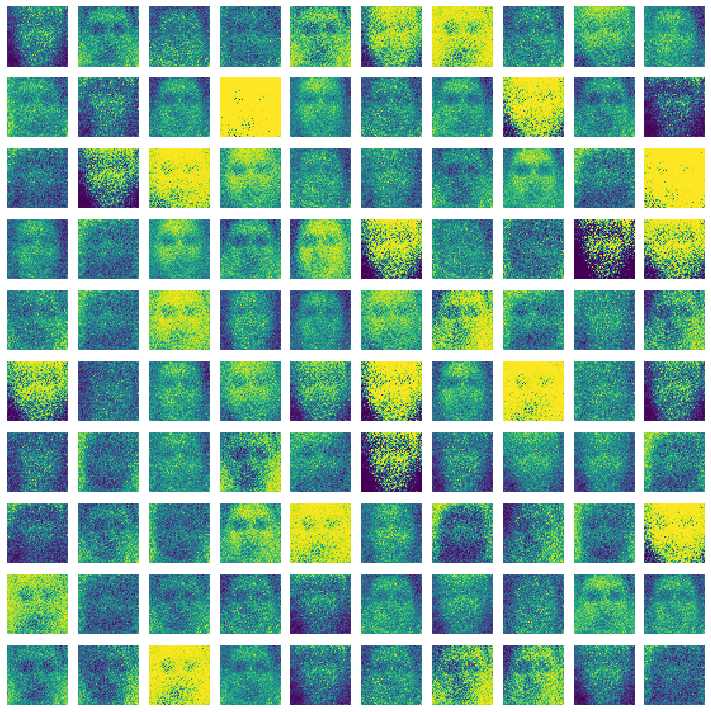

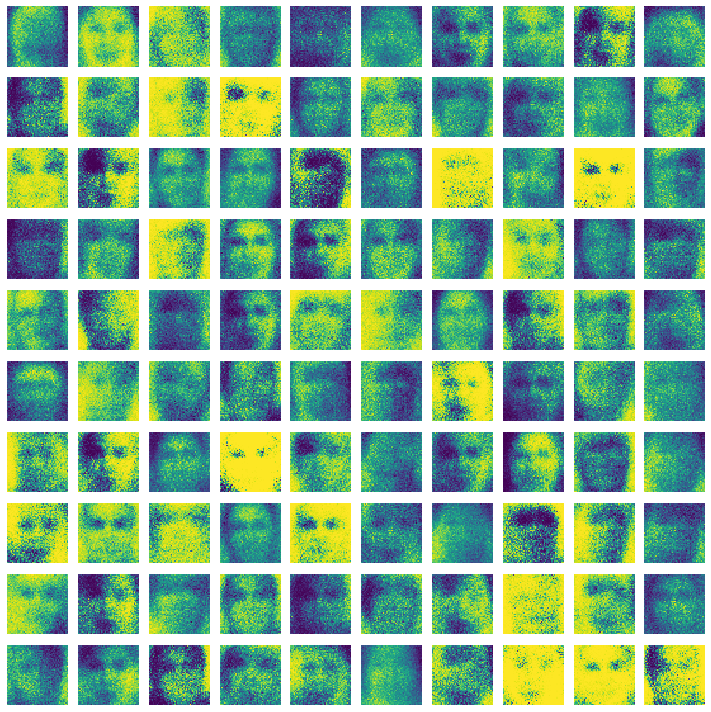

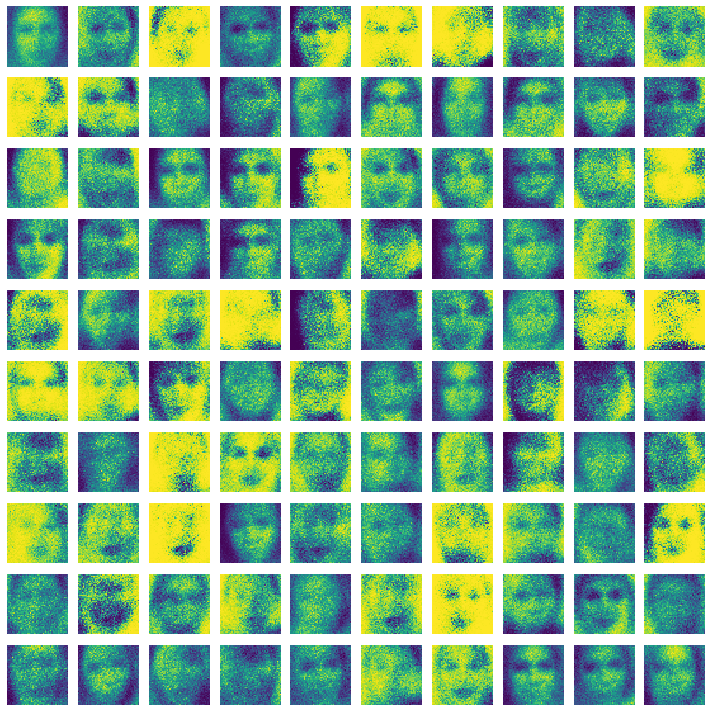

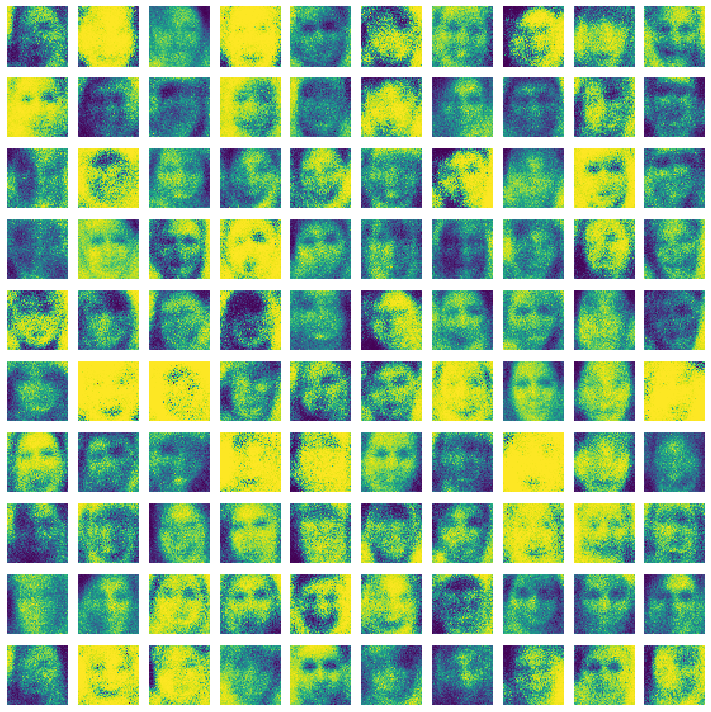

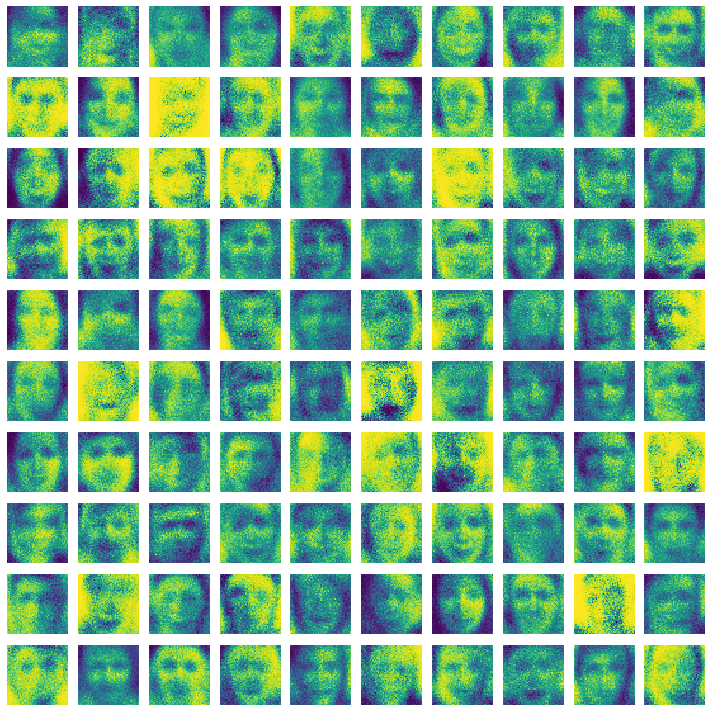

...

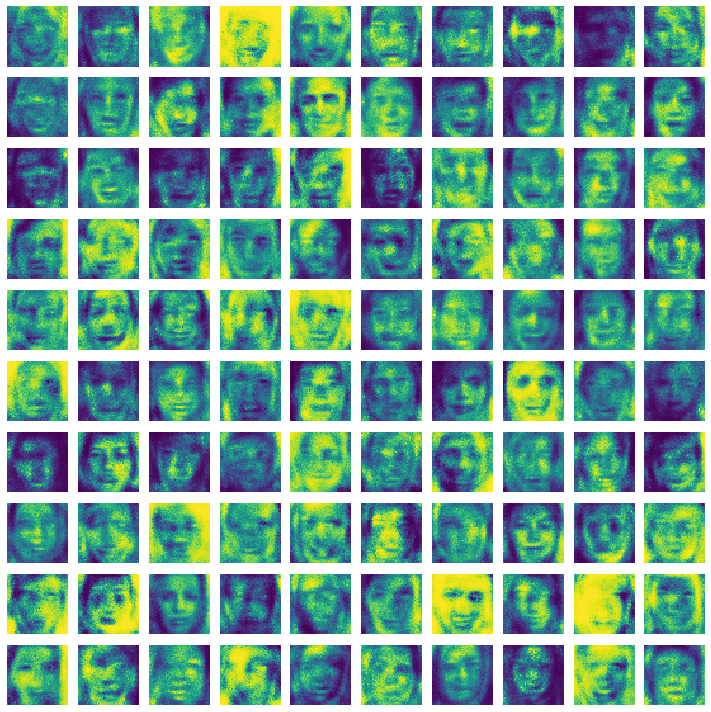

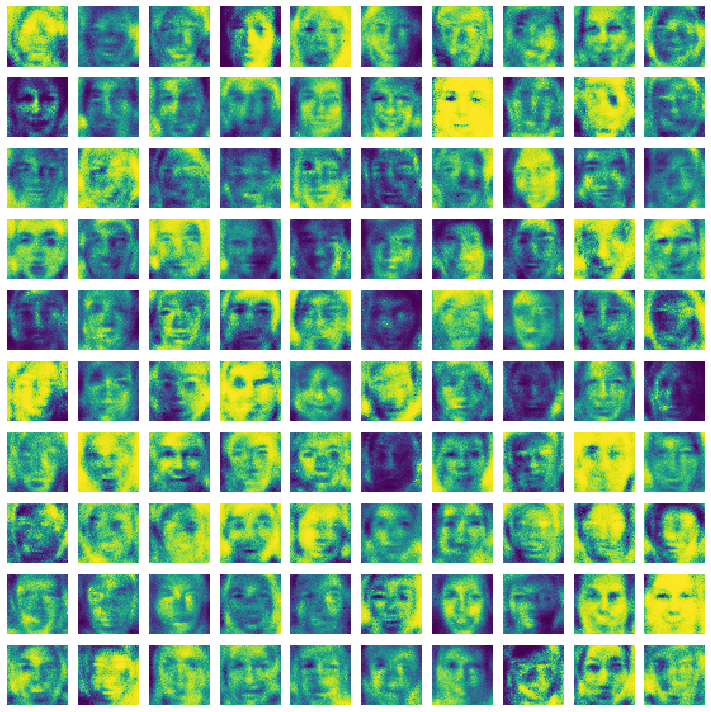

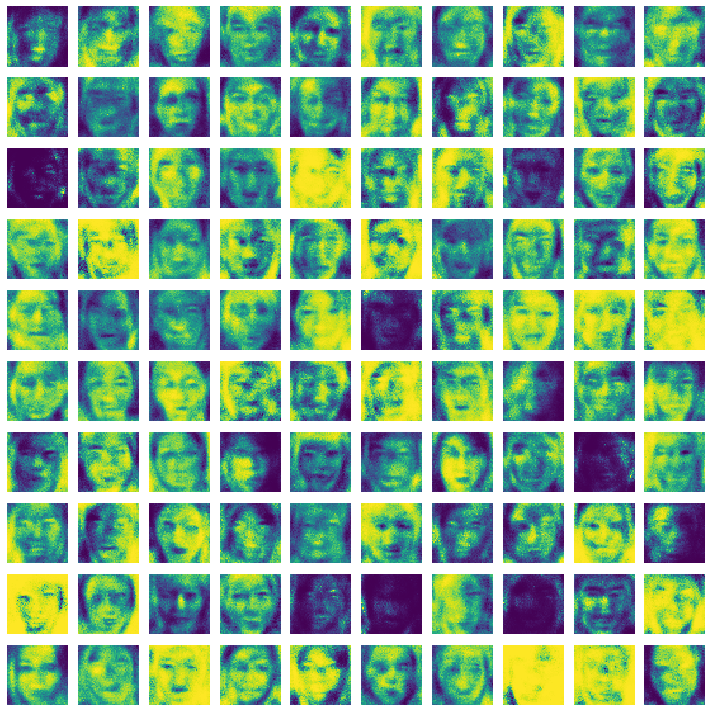

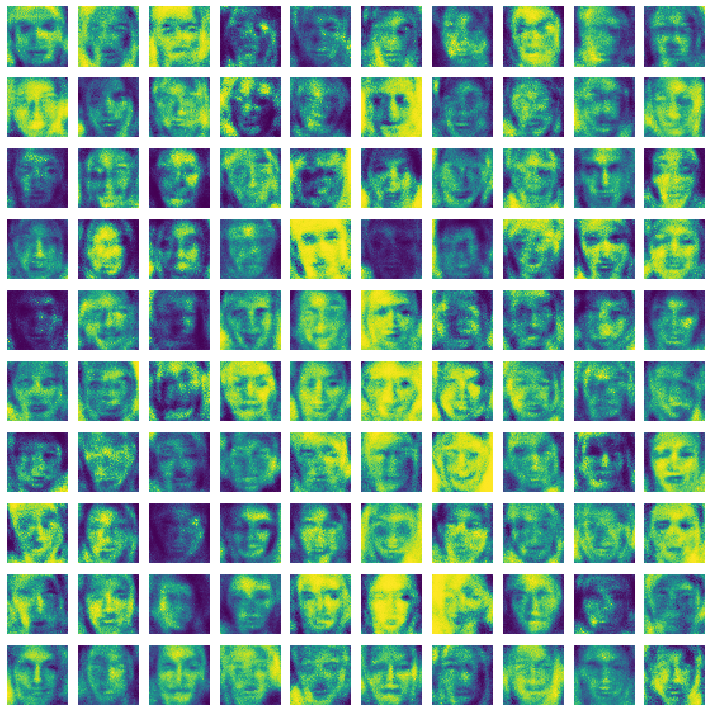

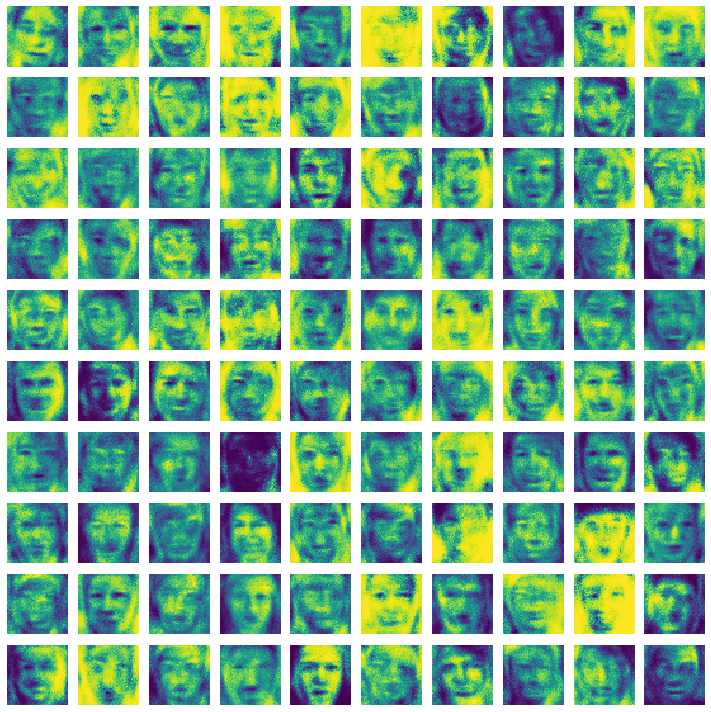

Buffered data was truncated after reaching the output size limit.

In [30]:
def training(epochs=1, batch_size=128):
    
    #Loading the data
    X_train = load_data()
    batch_count = X_train.shape[0] / batch_size
    
    # Creating GAN
    generator= create_generator()
    discriminator= create_discriminator()
    gan = create_gan(discriminator, generator)
    
    for e in range(1,epochs+1 ):
        print("Epoch %d" %e)
        for _ in tqdm(range(batch_size)):
        #generate  random noise as an input  to  initialize the  generator
            noise= np.random.normal(0,1, [batch_size, 100])
            
            # Generate fake MNIST images from noised input
            generated_images = generator.predict(noise)
            
            # Get a random set of  real images
            image_batch =X_train[np.random.randint(low=0,high=X_train.shape[0],size=batch_size)]
            
            #Construct different batches of  real and fake data 
            X= np.concatenate([image_batch, generated_images])
            
            # Labels for generated and real data
            y_dis=np.zeros(2*batch_size)
            y_dis[:batch_size]=0.9
            
            #Pre train discriminator on  fake and real data  before starting the gan. 
            discriminator.trainable=True
            discriminator.train_on_batch(X, y_dis)
            
            #Tricking the noised input of the Generator as real data
            noise= np.random.normal(0,1, [batch_size, 100])
            y_gen = np.ones(batch_size)
            
            # During the training of gan, 
            # the weights of discriminator should be fixed. 
            #We can enforce that by setting the trainable flag
            discriminator.trainable=False
            
            #training  the GAN by alternating the training of the Discriminator 
            #and training the chained GAN model with Discriminator’s weights freezed.
            gan.train_on_batch(noise, y_gen)
            
        if e % 5 == 0:
          plot_generated_images(e, generator)
training(1000,128)